In [1]:
import os
from enum import Enum
import cv2
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split
from tqdm import tqdm

In [2]:
def display_images(instances, rows=2, titles=None, figsize=(10, 5)):
    n = len(instances)
    cols = n // rows if (n / rows) % rows == 0 else (n // rows) + 1

    # Buat sebuah gambar (figure) dengan ukuran yang ditentukan
    fig = plt.figure(figsize=figsize)

    for j, image in enumerate(instances):
        plt.subplot(rows, cols, j + 1)
        plt.title('') if titles is None else plt.title(titles[j])
        plt.axis("off")
        plt.imshow(image)

    plt.show()

In [3]:
def one_hot_encode_masks(masks, num_classes):
    integer_encoded_labels = []

    for mask in tqdm(masks):
        _img_height, _img_width, _img_channels = mask.shape
        encoded_image = np.zeros((_img_height, _img_width, 1)).astype(int)

        for j, cls in enumerate(MaskColorMap):
            encoded_image[np.all(mask == cls.value, axis=-1)] = j

        integer_encoded_labels.append(encoded_image)

    return to_categorical(y=integer_encoded_labels, num_classes=num_classes)

In [4]:
class MaskColorMap(Enum):
    red = (255, 0, 0)
    green = (0, 255, 0)
    blue = (0, 0, 255)
    white = (255, 255, 255)
    black = (0, 0, 0)

In [5]:
# number of classes in segmentation dataset
n_classes = 5


In [6]:
n_classes

5

In [7]:
# Function to encode the mask to RGB
def rgb_encode_mask(mask):
    # Initialize rgb image with 3 channels (for RGB)
    rgb_encode_image = np.zeros((mask.shape[0], mask.shape[1], 3))

    # Iterate over MaskColorMap
    for j, cls in enumerate(MaskColorMap):
        # Convert single integer channel to RGB channels
        rgb_encode_image[mask == j] = np.array(cls.value) / 255.0
    
    return rgb_encode_image

In [8]:
#ganti nama file-images
import os
import shutil

def rename_files(source_folder, destination_folder):
    # Membuat folder tujuan jika belum ada
    os.makedirs(destination_folder, exist_ok=True)

    # Mendapatkan daftar file dalam folder sumber
    file_list = os.listdir(source_folder)

    # Mengurutkan file berdasarkan nama
    sorted_files = sorted(file_list)

    # Loop melalui setiap file
    for index, filename in enumerate(sorted_files):
        # Membangun path file lama dan baru
        old_path = os.path.join(source_folder, filename)
        new_filename = "training_" + str(index + 1) + ".png"
        new_path = os.path.join(destination_folder, new_filename)

        # Mengubah nama file dan memindahkannya ke folder tujuan
        shutil.copy2(old_path, new_path)

    print("Pengubahan nama dan pemindahan file selesai.")

# Contoh penggunaan
source_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/images"  # Ganti dengan path folder sumber
destination_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/images-all"  # Ganti dengan path folder tujuan
rename_files(source_folder, destination_folder)

Pengubahan nama dan pemindahan file selesai.


In [9]:
#ganti nama file-av
import os
import shutil

def rename_files(source_folder, destination_folder):
    # Membuat folder tujuan jika belum ada
    os.makedirs(destination_folder, exist_ok=True)

    # Mendapatkan daftar file dalam folder sumber
    file_list = os.listdir(source_folder)

    # Mengurutkan file berdasarkan nama
    sorted_files = sorted(file_list)

    # Loop melalui setiap file
    for index, filename in enumerate(sorted_files):
        # Membangun path file lama dan baru
        old_path = os.path.join(source_folder, filename)
        new_filename = "training_" + str(index + 1) + ".png"
        new_path = os.path.join(destination_folder, new_filename)

        # Mengubah nama file dan memindahkannya ke folder tujuan
        shutil.copy2(old_path, new_path)

    print("Pengubahan nama dan pemindahan file selesai.")

# Contoh penggunaan
source_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/av"  # Ganti dengan path folder sumber
destination_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/av-all"  # Ganti dengan path folder tujuan
rename_files(source_folder, destination_folder)

Pengubahan nama dan pemindahan file selesai.


In [10]:
#vertikal-images
import os
from PIL import Image
import shutil

def flip_images(input_folder, output_folder):
    # Membuat folder tujuan jika belum ada
    os.makedirs(output_folder, exist_ok=True)

    # Mengambil daftar file gambar dalam folder input
    image_files = [file for file in os.listdir(input_folder) if file.endswith(('.jpg', '.bmp','.BMP', '.png','tif'))]

    # Menentukan nomor awal untuk penomoran
    start_number = 0

    for i, file_name in enumerate(image_files):
        # Membaca gambar menggunakan PIL
        image_path = os.path.join(input_folder, file_name)
        image = Image.open(image_path)

        # Melakukan flip horizontal pada gambar
        flipped_image = image.transpose(Image.FLIP_TOP_BOTTOM)

        # Menentukan nomor untuk file hasil flip
        flipped_number = start_number + i + 1

        # Menyimpan gambar hasil flip dalam folder output dengan nomor urut
        flipped_output_path = os.path.join(output_folder, f"vert_{flipped_number}.png")
        flipped_image.save(flipped_output_path)

        print(f"Gambar {file_name} telah di-flip vertikal ")

    print("Proses flip dan penyimpanan selesai.")

# Menentukan folder input
input_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/images"

# Menentukan folder output untuk hasil flip vertikal
output_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/images-all"

# Memanggil fungsi flip_images
flip_images(input_folder, output_folder)


Gambar 01_test.tif telah di-flip vertikal 
Gambar 02_test.tif telah di-flip vertikal 
Gambar 03_test.tif telah di-flip vertikal 
Gambar 04_test.tif telah di-flip vertikal 
Gambar 05_test.tif telah di-flip vertikal 
Gambar 06_test.tif telah di-flip vertikal 
Gambar 07_test.tif telah di-flip vertikal 
Gambar 08_test.tif telah di-flip vertikal 
Gambar 09_test.tif telah di-flip vertikal 
Gambar 10_test.tif telah di-flip vertikal 
Gambar 11_test.tif telah di-flip vertikal 
Gambar 12_test.tif telah di-flip vertikal 
Gambar 13_test.tif telah di-flip vertikal 
Gambar 14_test.tif telah di-flip vertikal 
Gambar 15_test.tif telah di-flip vertikal 
Gambar 16_test.tif telah di-flip vertikal 
Gambar 17_test.tif telah di-flip vertikal 
Gambar 18_test.tif telah di-flip vertikal 
Gambar 19_test.tif telah di-flip vertikal 
Gambar 20_test.tif telah di-flip vertikal 
Gambar 21_training.tif telah di-flip vertikal 
Gambar 22_training.tif telah di-flip vertikal 
Gambar 23_training.tif telah di-flip vertikal 

In [11]:
#vertikal-av
import os
from PIL import Image
import shutil

def flip_images(input_folder, output_folder):
    # Membuat folder tujuan jika belum ada
    os.makedirs(output_folder, exist_ok=True)

    # Mengambil daftar file gambar dalam folder input
    image_files = [file for file in os.listdir(input_folder) if file.endswith(('.jpg', '.bmp','.BMP', '.png','tif'))]

    # Menentukan nomor awal untuk penomoran
    start_number = 0

    for i, file_name in enumerate(image_files):
        # Membaca gambar menggunakan PIL
        image_path = os.path.join(input_folder, file_name)
        image = Image.open(image_path)

        # Melakukan flip horizontal pada gambar
        flipped_image = image.transpose(Image.FLIP_TOP_BOTTOM)

        # Menentukan nomor untuk file hasil flip
        flipped_number = start_number + i + 1

        # Menyimpan gambar hasil flip dalam folder output dengan nomor urut
        flipped_output_path = os.path.join(output_folder, f"vert_{flipped_number}.png")
        flipped_image.save(flipped_output_path)

        print(f"Gambar {file_name} telah di-flip vertikal ")

    print("Proses flip dan penyimpanan selesai.")

# Menentukan folder input
input_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/av"

# Menentukan folder output untuk hasil flip vertikal
output_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/av-all"

# Memanggil fungsi flip_images
flip_images(input_folder, output_folder)


Gambar 01_test.png telah di-flip vertikal 
Gambar 02_test.png telah di-flip vertikal 
Gambar 03_test.png telah di-flip vertikal 
Gambar 04_test.png telah di-flip vertikal 
Gambar 05_test.png telah di-flip vertikal 
Gambar 06_test.png telah di-flip vertikal 
Gambar 07_test.png telah di-flip vertikal 
Gambar 08_test.png telah di-flip vertikal 
Gambar 09_test.png telah di-flip vertikal 
Gambar 10_test.png telah di-flip vertikal 
Gambar 11_test.png telah di-flip vertikal 
Gambar 12_test.png telah di-flip vertikal 
Gambar 13_test.png telah di-flip vertikal 
Gambar 14_test.png telah di-flip vertikal 
Gambar 15_test.png telah di-flip vertikal 
Gambar 16_test.png telah di-flip vertikal 
Gambar 17_test.png telah di-flip vertikal 
Gambar 18_test.png telah di-flip vertikal 
Gambar 19_test.png telah di-flip vertikal 
Gambar 20_test.png telah di-flip vertikal 
Gambar 21_training.png telah di-flip vertikal 
Gambar 22_training.png telah di-flip vertikal 
Gambar 23_training.png telah di-flip vertikal 

In [12]:
#horizontal flip-images
import os
from PIL import Image
import shutil

def flip_images(input_folder, output_folder):
    # Membuat folder tujuan jika belum ada
    os.makedirs(output_folder, exist_ok=True)

    # Mengambil daftar file gambar dalam folder input
    image_files = [file for file in os.listdir(input_folder) if file.endswith(('.jpg', '.BMP','bmp', '.png', 'tif'))]

    # Menentukan nomor awal untuk penomoran
    start_number = 0

    for i, file_name in enumerate(image_files):
        # Membaca gambar menggunakan PIL
        image_path = os.path.join(input_folder, file_name)
        image = Image.open(image_path)

        # Melakukan flip horizontal pada gambar
        flipped_image = image.transpose(Image.FLIP_LEFT_RIGHT)

        # Menentukan nomor untuk file hasil flip
        flipped_number = start_number + i + 1

        # Menyimpan gambar hasil flip dalam folder output dengan nomor urut
        flipped_output_path = os.path.join(output_folder, f"horizontal_{flipped_number}.png")
        flipped_image.save(flipped_output_path)

        print(f"Gambar {file_name} telah di-flip horizontal dan disimpan dengan nama file citra_{flipped_number}")

    print("Proses flip dan penyimpanan selesai.")

# Menentukan folder input
input_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/images"

# Menentukan folder output untuk hasil flip vertikal
output_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/images-all"

# Memanggil fungsi flip_images
flip_images(input_folder, output_folder)


Gambar 01_test.tif telah di-flip horizontal dan disimpan dengan nama file citra_1
Gambar 02_test.tif telah di-flip horizontal dan disimpan dengan nama file citra_2
Gambar 03_test.tif telah di-flip horizontal dan disimpan dengan nama file citra_3
Gambar 04_test.tif telah di-flip horizontal dan disimpan dengan nama file citra_4
Gambar 05_test.tif telah di-flip horizontal dan disimpan dengan nama file citra_5
Gambar 06_test.tif telah di-flip horizontal dan disimpan dengan nama file citra_6
Gambar 07_test.tif telah di-flip horizontal dan disimpan dengan nama file citra_7
Gambar 08_test.tif telah di-flip horizontal dan disimpan dengan nama file citra_8
Gambar 09_test.tif telah di-flip horizontal dan disimpan dengan nama file citra_9
Gambar 10_test.tif telah di-flip horizontal dan disimpan dengan nama file citra_10
Gambar 11_test.tif telah di-flip horizontal dan disimpan dengan nama file citra_11
Gambar 12_test.tif telah di-flip horizontal dan disimpan dengan nama file citra_12
Gambar 13_tes

In [13]:
#horizontal flip-av
import os
from PIL import Image
import shutil

def flip_images(input_folder, output_folder):
    # Membuat folder tujuan jika belum ada
    os.makedirs(output_folder, exist_ok=True)

    # Mengambil daftar file gambar dalam folder input
    image_files = [file for file in os.listdir(input_folder) if file.endswith(('.jpg', '.BMP','bmp', '.png', 'tif'))]

    # Menentukan nomor awal untuk penomoran
    start_number = 0

    for i, file_name in enumerate(image_files):
        # Membaca gambar menggunakan PIL
        image_path = os.path.join(input_folder, file_name)
        image = Image.open(image_path)

        # Melakukan flip horizontal pada gambar
        flipped_image = image.transpose(Image.FLIP_LEFT_RIGHT)

        # Menentukan nomor untuk file hasil flip
        flipped_number = start_number + i + 1

        # Menyimpan gambar hasil flip dalam folder output dengan nomor urut
        flipped_output_path = os.path.join(output_folder, f"horizontal_{flipped_number}.png")
        flipped_image.save(flipped_output_path)

        print(f"Gambar {file_name} telah di-flip horizontal dan disimpan dengan nama file citra_{flipped_number}")

    print("Proses flip dan penyimpanan selesai.")

# Menentukan folder input
input_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/av"

# Menentukan folder output untuk hasil flip vertikal
output_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/av-all"

# Memanggil fungsi flip_images
flip_images(input_folder, output_folder)


Gambar 01_test.png telah di-flip horizontal dan disimpan dengan nama file citra_1
Gambar 02_test.png telah di-flip horizontal dan disimpan dengan nama file citra_2
Gambar 03_test.png telah di-flip horizontal dan disimpan dengan nama file citra_3
Gambar 04_test.png telah di-flip horizontal dan disimpan dengan nama file citra_4
Gambar 05_test.png telah di-flip horizontal dan disimpan dengan nama file citra_5
Gambar 06_test.png telah di-flip horizontal dan disimpan dengan nama file citra_6
Gambar 07_test.png telah di-flip horizontal dan disimpan dengan nama file citra_7
Gambar 08_test.png telah di-flip horizontal dan disimpan dengan nama file citra_8
Gambar 09_test.png telah di-flip horizontal dan disimpan dengan nama file citra_9
Gambar 10_test.png telah di-flip horizontal dan disimpan dengan nama file citra_10
Gambar 11_test.png telah di-flip horizontal dan disimpan dengan nama file citra_11
Gambar 12_test.png telah di-flip horizontal dan disimpan dengan nama file citra_12
Gambar 13_tes

In [14]:
#rotate tes 2 (tanpa rubah ukuran piksel)-images
from PIL import Image
import os

def rotate_images_in_folder(source_folder, destination_folder, angle):
    if not os.path.exists(destination_folder):
        os.makedirs(destination_folder)

    image_files = [f for f in os.listdir(source_folder) if f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp', 'tif'))]

    for image_file in image_files:
        image_path = os.path.join(source_folder, image_file)
        img = Image.open(image_path)
        rotated_img = img.rotate(angle, resample=Image.BICUBIC, expand=True)
        
        # Resize the rotated image to match the original dimensions
        resized_rotated_img = rotated_img.resize(img.size, Image.BICUBIC)
        
        # Setelah rotasi, kita ubah nama file dan konversi ke format PNG
        new_filename = f"rotate_{os.path.splitext(image_file)[0]}.png"  # Menggunakan nama file asli tanpa ekstensi
        
        # Simpan gambar yang sudah dirotasi dan diubah namanya ke dalam folder tujuan dalam format PNG
        destination_path = os.path.join(destination_folder, new_filename)
        resized_rotated_img.save(destination_path, format='PNG')

if __name__ == "__main__":
    source_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/images"
    destination_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/images-all"
    rotation_angle = 90  # Set the desired rotation angle in degrees

    rotate_images_in_folder(source_folder, destination_folder, rotation_angle)
    print("Image rotation complete.")


Image rotation complete.


In [15]:
#rotate tes 2 (tanpa rubah ukuran piksel)-av
from PIL import Image
import os

def rotate_images_in_folder(source_folder, destination_folder, angle):
    if not os.path.exists(destination_folder):
        os.makedirs(destination_folder)

    image_files = [f for f in os.listdir(source_folder) if f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp','tif'))]

    for image_file in image_files:
        image_path = os.path.join(source_folder, image_file)
        img = Image.open(image_path)

        
        rotated_img = img.rotate(angle, resample=Image.BICUBIC, expand=True)
        
        # Resize the rotated image to match the original dimensions
        resized_rotated_img = rotated_img.resize(img.size, Image.BICUBIC)
        
        # Setelah rotasi, kita ubah nama file
     
        new_filename = f"rotate_{os.path.splitext(image_file)[0]}.png"  # Menggunakan nama file asli tanpa ekstensi
        
        # Simpan gambar yang sudah dirotasi dan diubah namanya ke dalam folder tujuan
        destination_path = os.path.join(destination_folder, new_filename)
        resized_rotated_img.save(destination_path)

if __name__ == "__main__":
    source_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/av"
    destination_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/av-all"
    rotation_angle = 90  # Set the desired rotation angle in degrees

    rotate_images_in_folder(source_folder, destination_folder, rotation_angle)
    print("Image rotation complete.")


Image rotation complete.


In [16]:
#rotate 180 (tanpa rubah ukuran piksel)-images
from PIL import Image
import os

def rotate_images_in_folder(source_folder, destination_folder, angle):
    if not os.path.exists(destination_folder):
        os.makedirs(destination_folder)

    image_files = [f for f in os.listdir(source_folder) if f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp', 'tif'))]

    for image_file in image_files:
        image_path = os.path.join(source_folder, image_file)
        img = Image.open(image_path)
        rotated_img = img.rotate(angle, resample=Image.BICUBIC, expand=True)
        
        # Resize the rotated image to match the original dimensions
        resized_rotated_img = rotated_img.resize(img.size, Image.BICUBIC)
        
        # Setelah rotasi, kita ubah nama file dan konversi ke format PNG
        new_filename = f"rotate_180_{os.path.splitext(image_file)[0]}.png"  # Menggunakan nama file asli tanpa ekstensi
        
        # Simpan gambar yang sudah dirotasi dan diubah namanya ke dalam folder tujuan dalam format PNG
        destination_path = os.path.join(destination_folder, new_filename)
        resized_rotated_img.save(destination_path, format='PNG')

if __name__ == "__main__":
    source_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/images"
    destination_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/images-all"
    rotation_angle = 180  # Set the desired rotation angle in degrees

    rotate_images_in_folder(source_folder, destination_folder, rotation_angle)
    print("Image rotation complete.")


Image rotation complete.


In [17]:
#rotate 180 (tanpa rubah ukuran piksel)-av
from PIL import Image
import os

def rotate_images_in_folder(source_folder, destination_folder, angle):
    if not os.path.exists(destination_folder):
        os.makedirs(destination_folder)

    image_files = [f for f in os.listdir(source_folder) if f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp', 'tif'))]

    for image_file in image_files:
        image_path = os.path.join(source_folder, image_file)
        img = Image.open(image_path)
        rotated_img = img.rotate(angle, resample=Image.BICUBIC, expand=True)
        
        # Resize the rotated image to match the original dimensions
        resized_rotated_img = rotated_img.resize(img.size, Image.BICUBIC)
        
        # Setelah rotasi, kita ubah nama file dan konversi ke format PNG
        new_filename = f"rotate_180_{os.path.splitext(image_file)[0]}.png"  # Menggunakan nama file asli tanpa ekstensi
        
        # Simpan gambar yang sudah dirotasi dan diubah namanya ke dalam folder tujuan dalam format PNG
        destination_path = os.path.join(destination_folder, new_filename)
        resized_rotated_img.save(destination_path, format='PNG')

if __name__ == "__main__":
    source_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/av"
    destination_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/av-all"
    rotation_angle = 180  # Set the desired rotation angle in degrees

    rotate_images_in_folder(source_folder, destination_folder, rotation_angle)
    print("Image rotation complete.")


Image rotation complete.


In [18]:
#rotate 270 (tanpa rubah ukuran piksel)-images
from PIL import Image
import os

def rotate_images_in_folder(source_folder, destination_folder, angle):
    if not os.path.exists(destination_folder):
        os.makedirs(destination_folder)

    image_files = [f for f in os.listdir(source_folder) if f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp', 'tif'))]

    for image_file in image_files:
        image_path = os.path.join(source_folder, image_file)
        img = Image.open(image_path)
        rotated_img = img.rotate(angle, resample=Image.BICUBIC, expand=True)
        
        # Resize the rotated image to match the original dimensions
        resized_rotated_img = rotated_img.resize(img.size, Image.BICUBIC)
        
        # Setelah rotasi, kita ubah nama file dan konversi ke format PNG
        new_filename = f"rotate_270_{os.path.splitext(image_file)[0]}.png"  # Menggunakan nama file asli tanpa ekstensi
        
        # Simpan gambar yang sudah dirotasi dan diubah namanya ke dalam folder tujuan dalam format PNG
        destination_path = os.path.join(destination_folder, new_filename)
        resized_rotated_img.save(destination_path, format='PNG')

if __name__ == "__main__":
    source_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/images"
    destination_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/images-all"
    rotation_angle = 270  # Set the desired rotation angle in degrees

    rotate_images_in_folder(source_folder, destination_folder, rotation_angle)
    print("Image rotation complete.")


Image rotation complete.


In [19]:
#rotate 270 (tanpa rubah ukuran piksel)- av
from PIL import Image
import os

def rotate_images_in_folder(source_folder, destination_folder, angle):
    if not os.path.exists(destination_folder):
        os.makedirs(destination_folder)

    image_files = [f for f in os.listdir(source_folder) if f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp','tif'))]

    for image_file in image_files:
        image_path = os.path.join(source_folder, image_file)
        img = Image.open(image_path)

        
        rotated_img = img.rotate(angle, resample=Image.BICUBIC, expand=True)
        
        # Resize the rotated image to match the original dimensions
        resized_rotated_img = rotated_img.resize(img.size, Image.BICUBIC)
        
        # Setelah rotasi, kita ubah nama file
     
        new_filename = f"rotate_270_{os.path.splitext(image_file)[0]}.png"  # Menggunakan nama file asli tanpa ekstensi
        
        # Simpan gambar yang sudah dirotasi dan diubah namanya ke dalam folder tujuan
        destination_path = os.path.join(destination_folder, new_filename)
        resized_rotated_img.save(destination_path)

if __name__ == "__main__":
    source_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/av"
    destination_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/av-all"
    rotation_angle = 270  # Set the desired rotation angle in degrees

    rotate_images_in_folder(source_folder, destination_folder, rotation_angle)
    print("Image rotation complete.")


Image rotation complete.


In [20]:
#vertikal-images-270
import os
from PIL import Image
import shutil

def flip_images(input_folder, output_folder):
    # Membuat folder tujuan jika belum ada
    os.makedirs(output_folder, exist_ok=True)

    # Mengambil daftar file gambar dalam folder input
    image_files = [file for file in os.listdir(input_folder) if file.endswith(('.jpg', '.bmp','.BMP', '.png','tif'))]

    # Menentukan nomor awal untuk penomoran
    start_number = 0

    for i, file_name in enumerate(image_files):
        # Membaca gambar menggunakan PIL
        image_path = os.path.join(input_folder, file_name)
        image = Image.open(image_path)

        # Melakukan flip horizontal pada gambar
        flipped_image = image.transpose(Image.FLIP_TOP_BOTTOM)

        # Menentukan nomor untuk file hasil flip
        flipped_number = start_number + i + 1

        # Menyimpan gambar hasil flip dalam folder output dengan nomor urut
        flipped_output_path = os.path.join(output_folder, f"vert-270_{flipped_number}.png")
        flipped_image.save(flipped_output_path)

        print(f"Gambar {file_name} telah di-flip vertikal ")

    print("Proses flip dan penyimpanan selesai.")

# Menentukan folder input
input_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/images"

# Menentukan folder output untuk hasil flip vertikal
output_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/images-all"

# Memanggil fungsi flip_images
flip_images(input_folder, output_folder)


Gambar 01_test.tif telah di-flip vertikal 
Gambar 02_test.tif telah di-flip vertikal 
Gambar 03_test.tif telah di-flip vertikal 
Gambar 04_test.tif telah di-flip vertikal 
Gambar 05_test.tif telah di-flip vertikal 
Gambar 06_test.tif telah di-flip vertikal 
Gambar 07_test.tif telah di-flip vertikal 
Gambar 08_test.tif telah di-flip vertikal 
Gambar 09_test.tif telah di-flip vertikal 
Gambar 10_test.tif telah di-flip vertikal 
Gambar 11_test.tif telah di-flip vertikal 
Gambar 12_test.tif telah di-flip vertikal 
Gambar 13_test.tif telah di-flip vertikal 
Gambar 14_test.tif telah di-flip vertikal 
Gambar 15_test.tif telah di-flip vertikal 
Gambar 16_test.tif telah di-flip vertikal 
Gambar 17_test.tif telah di-flip vertikal 
Gambar 18_test.tif telah di-flip vertikal 
Gambar 19_test.tif telah di-flip vertikal 
Gambar 20_test.tif telah di-flip vertikal 
Gambar 21_training.tif telah di-flip vertikal 
Gambar 22_training.tif telah di-flip vertikal 
Gambar 23_training.tif telah di-flip vertikal 

In [21]:
#vertikal-av-270
import os
from PIL import Image
import shutil

def flip_images(input_folder, output_folder):
    # Membuat folder tujuan jika belum ada
    os.makedirs(output_folder, exist_ok=True)

    # Mengambil daftar file gambar dalam folder input
    image_files = [file for file in os.listdir(input_folder) if file.endswith(('.jpg', '.bmp','.BMP', '.png','tif'))]

    # Menentukan nomor awal untuk penomoran
    start_number = 0

    for i, file_name in enumerate(image_files):
        # Membaca gambar menggunakan PIL
        image_path = os.path.join(input_folder, file_name)
        image = Image.open(image_path)

        # Melakukan flip horizontal pada gambar
        flipped_image = image.transpose(Image.FLIP_TOP_BOTTOM)

        # Menentukan nomor untuk file hasil flip
        flipped_number = start_number + i + 1

        # Menyimpan gambar hasil flip dalam folder output dengan nomor urut
        flipped_output_path = os.path.join(output_folder, f"vert-270_{flipped_number}.png")
        flipped_image.save(flipped_output_path)

        print(f"Gambar {file_name} telah di-flip vertikal ")

    print("Proses flip dan penyimpanan selesai.")

# Menentukan folder input
input_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/av"

# Menentukan folder output untuk hasil flip vertikal
output_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/av-all"

# Memanggil fungsi flip_images
flip_images(input_folder, output_folder)


Gambar 01_test.png telah di-flip vertikal 
Gambar 02_test.png telah di-flip vertikal 
Gambar 03_test.png telah di-flip vertikal 
Gambar 04_test.png telah di-flip vertikal 
Gambar 05_test.png telah di-flip vertikal 
Gambar 06_test.png telah di-flip vertikal 
Gambar 07_test.png telah di-flip vertikal 
Gambar 08_test.png telah di-flip vertikal 
Gambar 09_test.png telah di-flip vertikal 
Gambar 10_test.png telah di-flip vertikal 
Gambar 11_test.png telah di-flip vertikal 
Gambar 12_test.png telah di-flip vertikal 
Gambar 13_test.png telah di-flip vertikal 
Gambar 14_test.png telah di-flip vertikal 
Gambar 15_test.png telah di-flip vertikal 
Gambar 16_test.png telah di-flip vertikal 
Gambar 17_test.png telah di-flip vertikal 
Gambar 18_test.png telah di-flip vertikal 
Gambar 19_test.png telah di-flip vertikal 
Gambar 20_test.png telah di-flip vertikal 
Gambar 21_training.png telah di-flip vertikal 
Gambar 22_training.png telah di-flip vertikal 
Gambar 23_training.png telah di-flip vertikal 

In [22]:
#gaussian_blur
import os
import cv2

def gaussian_blur_folder(input_folder, output_folder, kernel_size=(5, 5)):
    # Membuat folder output jika belum ada
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Mendapatkan daftar nama file dalam folder input
    file_list = os.listdir(input_folder)

    for filename in file_list:
        # Mengabaikan file yang bukan gambar
        if not filename.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp', '.tif', '.tiff')):
            continue

        # Baca gambar dari file
        img_path = os.path.join(input_folder, filename)
        img = cv2.imread(img_path)

        # Lakukan Gaussian blur
        blurred_img = cv2.GaussianBlur(img, kernel_size, 0)

        # Simpan gambar hasil ke folder output dengan nama yang sama
        output_path = os.path.join(output_folder, filename)
        cv2.imwrite(output_path, blurred_img)

        print(f"Processed: {filename}")

# Memasukkan folder input dan output yang diinginkan
input_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/images-all"
output_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/images-all-gaussian-blur"

# Panggil fungsi gaussian_blur_folder dengan folder input dan output yang ditentukan
gaussian_blur_folder(input_folder, output_folder)


Processed: horizontal_1.png
Processed: horizontal_10.png
Processed: horizontal_11.png
Processed: horizontal_12.png
Processed: horizontal_13.png
Processed: horizontal_14.png
Processed: horizontal_15.png
Processed: horizontal_16.png
Processed: horizontal_17.png
Processed: horizontal_18.png
Processed: horizontal_19.png
Processed: horizontal_2.png
Processed: horizontal_20.png
Processed: horizontal_21.png
Processed: horizontal_22.png
Processed: horizontal_23.png
Processed: horizontal_24.png
Processed: horizontal_25.png
Processed: horizontal_26.png
Processed: horizontal_27.png
Processed: horizontal_28.png
Processed: horizontal_29.png
Processed: horizontal_3.png
Processed: horizontal_30.png
Processed: horizontal_31.png
Processed: horizontal_32.png
Processed: horizontal_33.png
Processed: horizontal_34.png
Processed: horizontal_35.png
Processed: horizontal_36.png
Processed: horizontal_37.png
Processed: horizontal_38.png
Processed: horizontal_39.png
Processed: horizontal_4.png
Processed: horizon

In [23]:
import os
import cv2
#clahe based on stackoferflow
def apply_clahe_to_folder(input_folder, output_folder, gridsize):
    # Membuat folder output jika belum ada
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
 
    # Mendapatkan daftar file dalam folder input
    image_files = os.listdir(input_folder)

    # Mengiterasi melalui setiap file citra dalam folder input
    for image_file in image_files:
        # Membuat jalur lengkap untuk citra input
        input_image_path = os.path.join(input_folder, image_file)

        # Membaca citra RGB
        bgr = cv2.imread(input_image_path)

        # Mengonversi citra ke ruang warna LAB
        lab = cv2.cvtColor(bgr, cv2.COLOR_BGR2LAB)

        # Membagi komponen warna LAB
        lab_planes = cv2.split(lab)

        # Membuat objek CLAHE
        clahe = cv2.createCLAHE(clipLimit=1.0, tileGridSize=(gridsize, gridsize))

        # Mengaplikasikan CLAHE pada komponen L (Brightness) LAB
        lab_planes_list = list(lab_planes)  # Mengonversi tuple ke list
        lab_planes_list[0] = clahe.apply(lab_planes_list[0])
        lab_planes = tuple(lab_planes_list)  # Mengonversi kembali list ke tuple


        # Menggabungkan kembali komponen warna LAB
        lab = cv2.merge(lab_planes)

        # Mengonversi citra kembali ke ruang warna BGR
        bgr = cv2.cvtColor(lab, cv2.COLOR_LAB2BGR)

        # Membuat jalur lengkap untuk citra output
        output_image_path = os.path.join(output_folder, image_file)

        # Menyimpan citra hasil ke folder output
        cv2.imwrite(output_image_path, bgr)
 
    print("CLAHE telah diterapkan pada semua citra dalam folder.")

# Contoh penggunaan
input_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/images-all-gaussian-blur"
output_folder = "D:/Gio&Maul/gio/AV_groundTruth/training/images-all-clahe"
gridsize = 8  # Atur sesuai kebutuhan Anda
apply_clahe_to_folder(input_folder, output_folder, gridsize)

CLAHE telah diterapkan pada semua citra dalam folder.


In [24]:
import glob
import cv2 as cv

# Mendapatkan daftar file citra dalam direktori dan mengurutkannya
X = sorted(glob.glob('D:/Gio&Maul/gio/AV_groundTruth/training/images-all-clahe/*.png'))
Y = sorted(glob.glob('D:/Gio&Maul/gio/AV_groundTruth/training/av-all/*.png'))

In [25]:
x_train= []

for i in range(len(X)):
    x = cv.imread(X[i])
    x = cv2.cvtColor(x,cv2.COLOR_BGR2RGB)
    x = cv2.resize(x,(256,256))
    x_train.append(x)

X= np.array(x_train)
len(X)


280

In [26]:
# Prepare the Labels
y_train = []
for i in range(len(Y)):
    y = cv.imread(Y[i])
    y = cv2.cvtColor(y, cv2.COLOR_BGR2RGB)
    y = cv2.resize(y,(256,256))
    y_train.append(y)

Y= np.array(y_train)
len(Y)

280

In [27]:
img_channels = 5
m, img_height, img_width, img_channels = X.shape
X.shape

(280, 256, 256, 3)

In [28]:
Y.shape

(280, 256, 256, 3)

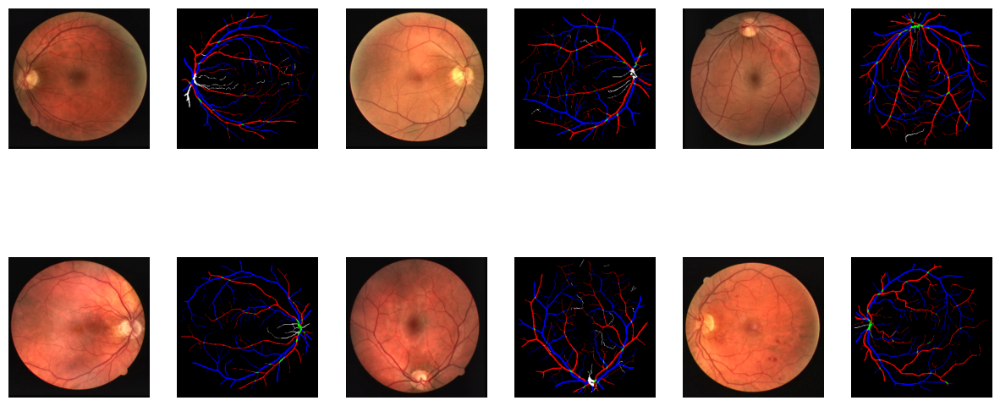

In [29]:
import matplotlib.pyplot as plt

# Set the number of images to display
display_count = 6

# Generate random indices
random_index = [np.random.randint(0, m) for _ in range(display_count)]

# Get the sample images
sample_images = [x for z in zip(list(X[random_index]), list(Y[random_index])) for x in z]

# Set the number of rows and columns for display
rows = 2
columns = display_count if display_count % 2 == 0 else display_count + 1

# Create a subplot and display images in a larger size
plt.figure(figsize=(15, 7))  # Adjust the figsize to your preferred size
for i, image in enumerate(sample_images):
    plt.subplot(rows, columns, i + 1)
    plt.imshow(image)
    plt.axis('off')

plt.show()


In [30]:
X.shape

(280, 256, 256, 3)

In [31]:
Y.shape

(280, 256, 256, 3)

In [32]:
# convert RGB values to integer encoded labels for categorical_crossentropy
Y = one_hot_encode_masks(Y, num_classes=n_classes)

# split dataset into training and test groups
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.1, random_state=42)

100%|██████████| 280/280 [00:01<00:00, 142.71it/s]


In [33]:
print("X_train shape =",X_train.shape)

X_train shape = (252, 256, 256, 3)


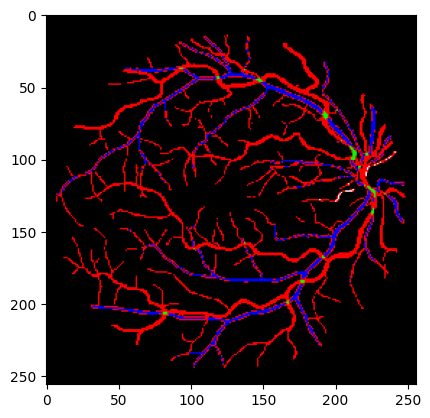

In [35]:
# Warna untuk setiap kelas (merah, hijau, biru, putih, hitam)
colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 255), (0, 0, 0)]

# Buat gambar RGB kosong
mask_rgb = np.zeros((256, 256, 3), dtype=np.uint8)

# Iterasi setiap kelas dan tambahkan warna ke gambar RGB
for i, color in enumerate(colors):
    mask_rgb[Y[0][:, :, i] == 1] = color

# Tampilkan mask dalam format RGB
plt.imshow(mask_rgb)
plt.show()


In [36]:
import tensorflow as tf
import tensorflow.keras.layers as L
from tensorflow.keras.models import Model
#Vision Transformer Components
from tensorflow.keras.layers import Layer, Dense, Dropout, LayerNormalization, MultiHeadAttention, Add, Embedding, Concatenate
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

#ClassToken
class ClassToken(Layer):
    def __init__(self):
        super().__init__()

    def build(self, input_shape):
        w_init = tf.random_normal_initializer()
        self.w = tf.Variable(
            initial_value = w_init(shape=(1, 1, input_shape[-1]), dtype=tf.float32),
            trainable = True
        )

    def call(self, inputs):
        batch_size = tf.shape(inputs)[0]
        hidden_dim = self.w.shape[-1]

        cls = tf.broadcast_to(self.w, [batch_size, 1, hidden_dim])
        cls = tf.cast(cls, dtype=inputs.dtype)
        return cls

def mlp(x, cf):
    x = Dense(cf["mlp_dim"], activation="gelu")(x)
    x = Dropout(cf["dropout_rate"])(x)
    x = Dense(cf["hidden_dim"])(x)
    x = Dropout(cf["dropout_rate"])(x)
    return x

def transformer_encoder(x, cf):
    skip_1 = x
    x = LayerNormalization()(x)
    x = MultiHeadAttention(
        num_heads=cf["num_heads"], key_dim=cf["hidden_dim"]
    )(x, x)
    x = Add()([x, skip_1])

    skip_2 = x
    x = LayerNormalization()(x)
    x = mlp(x, cf)
    x = Add()([x, skip_2])

    return x

#ViT Block
def Vit_block(inputs, cf):
    input_shape = (cf["num_patches"], cf["patch_size"]*cf["patch_size"]*cf["num_channels"])
    x = Dense(cf["hidden_dim"])(inputs)
    positions = tf.range(start=0, limit=cf["num_patches"], delta=1)
    pos_embed = Embedding(input_dim=cf["num_patches"], output_dim=cf["hidden_dim"])(positions)
    x = x + pos_embed
    token = ClassToken()(x)
    x = Concatenate(axis=1)([token, x])

    for _ in range(cf["num_layers"]):
        x = transformer_encoder(x, cf)
    
    x = LayerNormalization()(x)
    x = x[:, 1:, :]  # Skip the class token
    return x

#Resunet++
def SE(inputs, ratio=8):
    channel_axis = -1
    num_filters = inputs.shape[channel_axis]
    se_shape = (1, 1, num_filters)
 
    x = L.GlobalAveragePooling2D()(inputs)
    x = L.Reshape(se_shape)(x)
    x = L.Dense(num_filters // ratio, activation='relu', use_bias=False)(x)
    x = L.Dense(num_filters, activation='sigmoid', use_bias=False)(x)
 
    x = L.Multiply()([inputs, x])
    return x

def stem_block(inputs, num_filters, strides=1):
    ## Conv 1
    x = L.Conv2D(num_filters, 3, padding="same", strides=strides)(inputs)
    x = L.BatchNormalization()(x)
    x = L.Activation("relu")(x)
    x = L.Conv2D(num_filters, 3, padding="same")(x)
 
    ## Shortcut
    s = L.Conv2D(num_filters, 1, padding="same", strides=strides)(inputs)
    s = L.BatchNormalization()(s)
 
    ## Add
    x = L.Add()([x, s])
    x = SE(x)
    return x

def resnet_block(inputs, num_filter, strides=1):
 
    ## Conv 1
    x = L.BatchNormalization()(inputs)
    x = L.Activation("relu")(x)
    x = L.Conv2D(num_filter, 3, padding="same", strides=strides)(x)
  
    ## Conv 2
    x = L.BatchNormalization()(x)
    x = L.Activation("relu")(x)
    x = L.Conv2D(num_filter, 3, padding="same", strides=1)(x)
 
    ## Shortcut
    s = L.Conv2D(num_filter, 1, padding="same", strides=strides)(inputs)
    s = L.BatchNormalization()(s)
 
    ## Add
    x = L.Add()([x, s])
    x = SE(x)
    return x

def aspp_block(inputs, num_filters):
    x1 = L.Conv2D(num_filters, 3, dilation_rate=6, padding="same")(inputs)
    x1 = L.BatchNormalization()(x1)
 
    x2 = L.Conv2D(num_filters, 3, dilation_rate=12, padding="same")(inputs)
    x2 = L.BatchNormalization()(x2)
 
    x3 = L.Conv2D(num_filters, 3, dilation_rate=18, padding="same")(inputs)
    x3 = L.BatchNormalization()(x3)
 
    x4 = L.Conv2D(num_filters, (3, 3), padding="same")(inputs)
    x4 = L.BatchNormalization()(x4)
 
    y = L.Add()([x1, x2, x3, x4])
    y = L.Conv2D(num_filters, 1, padding="same")(y)
    return y

def attetion_block(x1, x2):
    num_filters = x2.shape[-1]
 
    x1_conv = L.BatchNormalization()(x1)
    x1_conv = L.Activation("relu")(x1_conv)
    x1_conv = L.Conv2D(num_filters, 3, padding="same")(x1_conv)
    x1_pool = L.MaxPooling2D((2, 2))(x1_conv)
 
    x2_conv = L.BatchNormalization()(x2)
    x2_conv = L.Activation("relu")(x2_conv)
    x2_conv = L.Conv2D(num_filters, 3, padding="same")(x2_conv)
 
    x = L.Add()([x1_pool, x2_conv])
 
    x = L.BatchNormalization()(x)
    x = L.Activation("relu")(x)
    x = L.Conv2D(num_filters, 3, padding="same")(x)
 
    x = L.Multiply()([x, x2])
    return x

def resunet_pp_with_vit(input_shape, num_classes=5):
    """ Inputs """
    inputs = L.Input(input_shape)

    """ ViT Block """
    patch_size = vit_config["patch_size"]
    num_patches = (input_shape[0] // patch_size) * (input_shape[1] // patch_size)
    vit_inputs = L.Reshape((num_patches, patch_size * patch_size * input_shape[2]))(inputs)
    vit_features = Vit_block(vit_inputs, vit_config)
    vit_features = L.Reshape((input_shape[0] // patch_size, input_shape[1] // patch_size, vit_config["hidden_dim"]))(vit_features)
    
    """ Encoder """
    c1 = stem_block(inputs, 8, strides=1)
    c2 = resnet_block(c1, 16, strides=2)
    c3 = resnet_block(c2, 32, strides=2)
    c4 = resnet_block(c3, 64, strides=2)
 
    """ Bridge """
    b1 = aspp_block(c4, 128)
    
    """ Decoder """
    d1 = attetion_block(c3, b1)
    d1 = L.UpSampling2D((2, 2))(d1)
    d1 = L.Concatenate()([d1, c3])
    d1 = resnet_block(d1, 64)
 
    d2 = attetion_block(c2, d1)
    d2 = L.UpSampling2D((2, 2))(d2)
    d2 = L.Concatenate()([d2, c2])
    d2 = resnet_block(d2, 32)
 
    d3 = attetion_block(c1, d2)
    d3 = L.UpSampling2D((2, 2))(d3)
    d3 = L.Concatenate()([d3, c1])
    d3 = resnet_block(d3, 16)
 
    """ Output"""
    outputs = aspp_block(d3, 8)
    outputs = L.Conv2D(5, 1, padding="same")(outputs)
    outputs = L.Activation("sigmoid")(outputs)
 
    """ Model """
    model = Model(inputs, outputs)
    return model

In [37]:
img_channels = 5
img_shape=(img_height, img_width,img_channels)
img_shape

(256, 256, 5)

In [38]:
X.shape

(280, 256, 256, 3)

In [39]:
Y.shape

(280, 256, 256, 5)

In [40]:
from tensorflow.keras import backend as K
import tensorflow as tf

# jaccard similarity: the size of the intersection divided by the size of the union of two sets
def iou_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (intersection + 1.0) / (K.sum(y_true_f) + K.sum(y_pred_f) - intersection+1.0)

In [41]:
vit_config = {
    "num_patches": 256,
    "patch_size": 16,
    "num_channels": 5,
    "hidden_dim": 256,
    "num_heads": 8,
    "mlp_dim": 1024,
    "num_layers": 8,
    "dropout_rate": 0.1
}

# Bentuk input
img_height = 256
img_width = 256
img_channels = 3
input_shape = (img_height, img_width, img_channels)

# Inisialisasi model
model = resunet_pp_with_vit(input_shape, vit_config)

# Compile model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Inisialisasi callback
early_stopping = EarlyStopping(monitor='val_loss', patience=10, verbose=1, mode='min')
checkpoint = ModelCheckpoint('best_model.h5', monitor='val_loss', verbose=1, save_best_only=True, mode='min')

# Ringkasan model
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 256, 256, 8)  224         ['input_1[0][0]']                
                                                                                                  
 batch_normalization (BatchNorm  (None, 256, 256, 8)  32         ['conv2d[0][0]']                 
 alization)                                                                                       
                                                                                              

In [42]:
# datetime for filename saving
model_save_path = "D:/Gio&Maul/gio/AV_groundTruth/mresuneta-4.hdf5"
#csv_logger = rf"{os.getcwd()}/logs2/aerial_segmentation_log_{dt_now}.csv"# datetime for filename saving
model_save_path = "D:/Gio&Maul/gio/AV_groundTruth/mresuneta-4.hdf5"
#csv_logger = rf"{os.getcwd()}/logs2/aerial_segmentation_log_{dt_now}.csv"

In [43]:
# =======================================================
# add callbacks, compile model and fit training data
from tensorflow.keras.callbacks import EarlyStopping
# save best model with maximum validation accuracy
#checkpoint = ModelCheckpoint(model_checkpoint_filepath, monitor="val_accuracy", verbose=1, save_best_only=True,
                #mode="max")

# stop model training early if validation loss doesn't continue to decrease over 2 iterations
#early_stopping = EarlyStopping(monitor="val_loss", patience=2, verbose=1, mode="min")
#early_stopping = EarlyStopping(monitor='val_accuracy', patience=20, min_delta=0, verbose=1, mode='auto')
# log training console output to csva
#csv_logger = CSVLogger(csv_logger, separator=",", append=False)

# create list of callbacks
#callbacks_list = [checkpoint]  # early_stopping

# train and save model
history = model.fit(X_train, Y_train, epochs=50, batch_size=2, validation_data=(X_test, Y_test), verbose=1)
model.save(model_save_path)
print("model saved:", model_save_path)

# =====================================================

Epoch 1/50
126/126 [==============================] - 16s 65ms/step - loss: 0.8613 - accuracy: 0.8092 - val_loss: 0.4937 - val_accuracy: 0.8712
Epoch 2/50
126/126 [==============================] - 7s 57ms/step - loss: 0.2804 - accuracy: 0.9114 - val_loss: 0.3933 - val_accuracy: 0.8759
Epoch 3/50
126/126 [==============================] - 7s 57ms/step - loss: 0.2403 - accuracy: 0.9181 - val_loss: 0.2404 - val_accuracy: 0.9136
Epoch 4/50
126/126 [==============================] - 7s 57ms/step - loss: 0.2208 - accuracy: 0.9223 - val_loss: 0.2304 - val_accuracy: 0.9200
Epoch 5/50
126/126 [==============================] - 7s 57ms/step - loss: 0.2075 - accuracy: 0.9257 - val_loss: 0.2105 - val_accuracy: 0.9241
Epoch 6/50
126/126 [==============================] - 7s 57ms/step - loss: 0.2012 - accuracy: 0.9269 - val_loss: 0.2154 - val_accuracy: 0.9276
Epoch 7/50
126/126 [==============================] - 7s 57ms/step - loss: 0.1934 - accuracy: 0.9295 - val_loss: 0.2011 - val_accuracy: 0.929

-----------------------------------------
keras-unet init: TF version is >= 2.0.0 - using `tf.keras` instead of `Keras`
-----------------------------------------


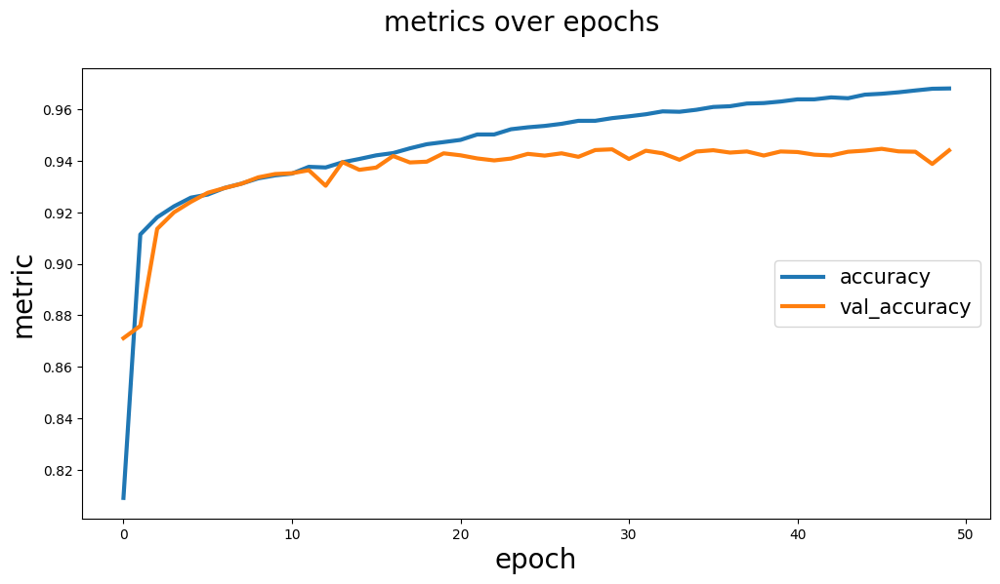

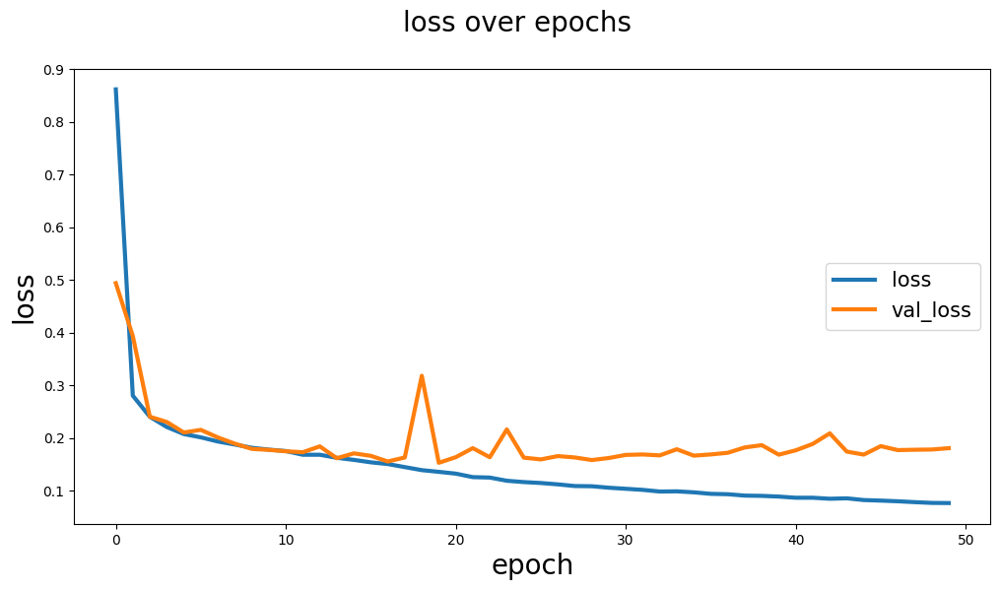

In [44]:
from keras_unet.utils import plot_segm_history
import matplotlib.pyplot as plt

# plot_segm_history code

# Plot the history
plot_segm_history(
    history,
    metrics=['accuracy', 'val_accuracy'],
    losses=['loss', 'val_loss']
)


In [45]:
X_test.shape

(28, 256, 256, 3)

In [46]:
X

array([[[[ 3,  3,  3],
         [ 3,  3,  3],
         [ 3,  3,  3],
         ...,
         [ 3,  3,  3],
         [ 3,  3,  3],
         [ 3,  3,  3]],

        [[ 3,  3,  3],
         [ 3,  3,  3],
         [ 3,  3,  3],
         ...,
         [ 6,  6,  6],
         [ 3,  3,  3],
         [ 6,  6,  6]],

        [[ 3,  3,  3],
         [ 3,  3,  3],
         [ 3,  3,  3],
         ...,
         [ 6,  6,  6],
         [ 6,  6,  6],
         [ 5,  5,  5]],

        ...,

        [[16, 11, 15],
         [16, 11, 15],
         [16, 11, 15],
         ...,
         [10, 10, 10],
         [10, 10, 10],
         [10, 10, 10]],

        [[15, 11, 16],
         [12, 13, 15],
         [15, 11, 16],
         ...,
         [10, 10, 10],
         [10, 10, 10],
         [10, 10, 10]],

        [[ 5,  8, 11],
         [ 6,  8, 10],
         [11, 11, 12],
         ...,
         [10, 10, 10],
         [10, 10, 10],
         [10, 10, 10]]],


       [[[ 3,  3,  3],
         [ 3,  3,  3],
         [ 3, 

1/1 [==============================] - 1s 1s/step


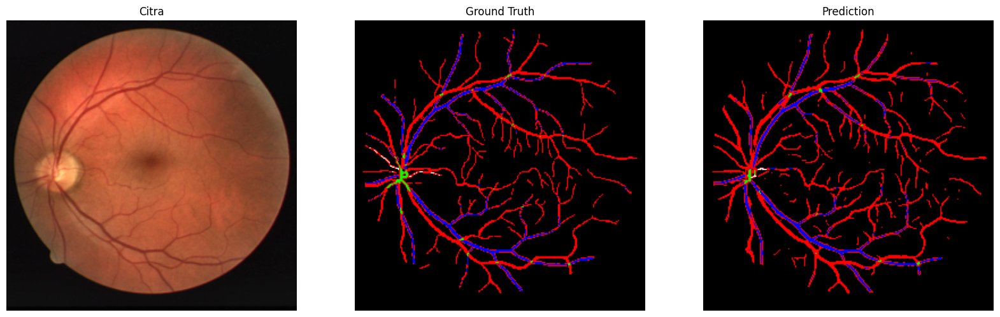

1/1 [==============================] - 0s 41ms/step


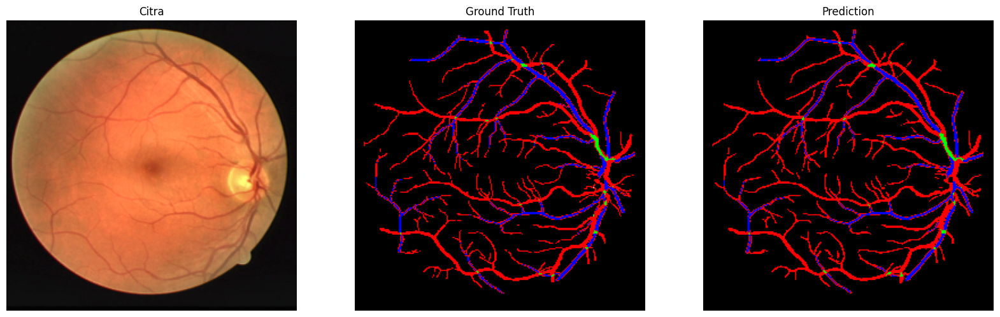

1/1 [==============================] - 0s 23ms/step


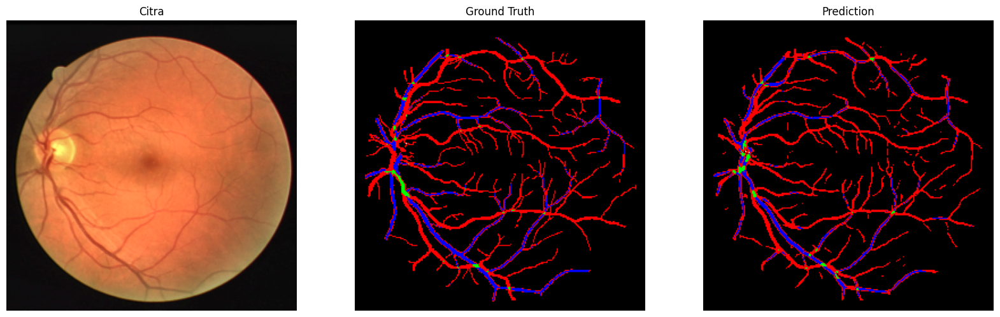

1/1 [==============================] - 0s 23ms/step


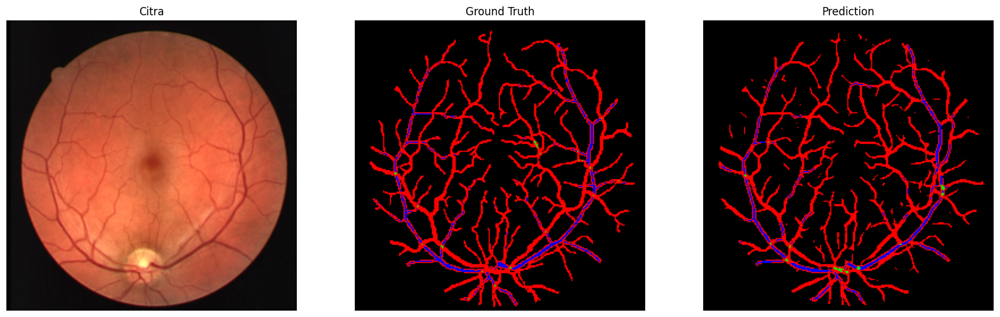

1/1 [==============================] - 0s 36ms/step


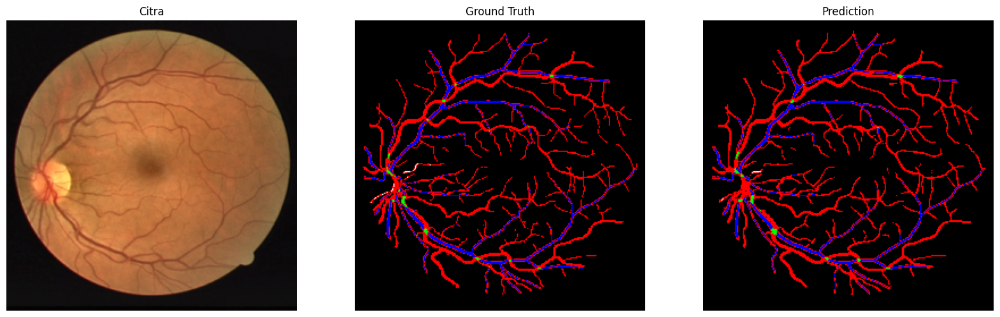

1/1 [==============================] - 0s 43ms/step


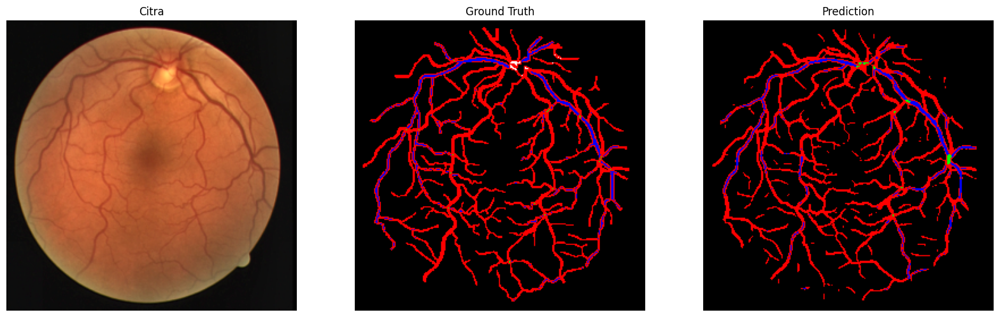

1/1 [==============================] - 0s 31ms/step


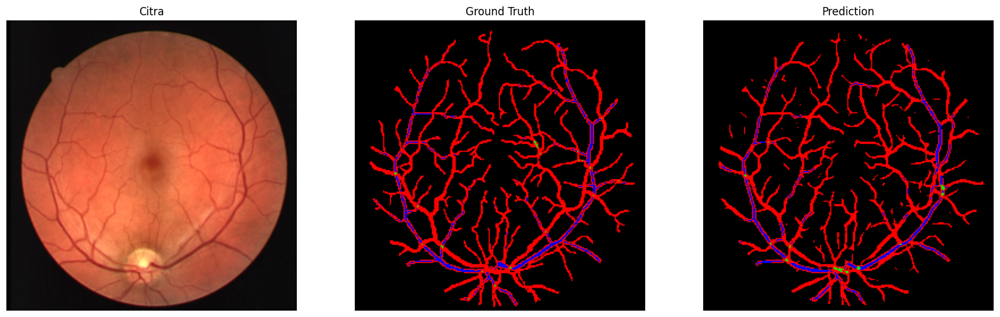

1/1 [==============================] - 0s 33ms/step


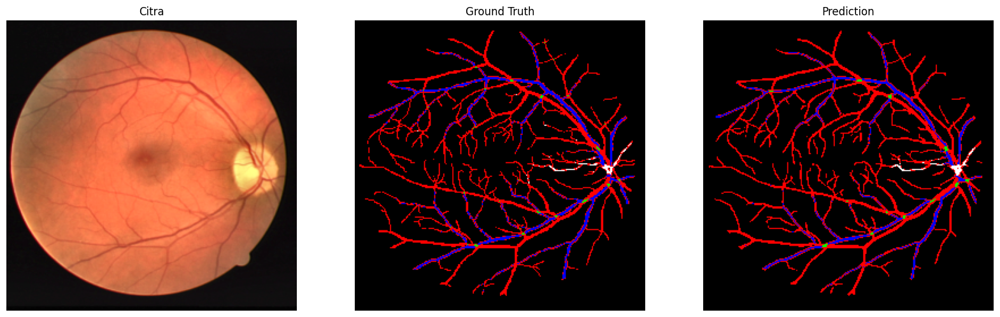

1/1 [==============================] - 0s 35ms/step


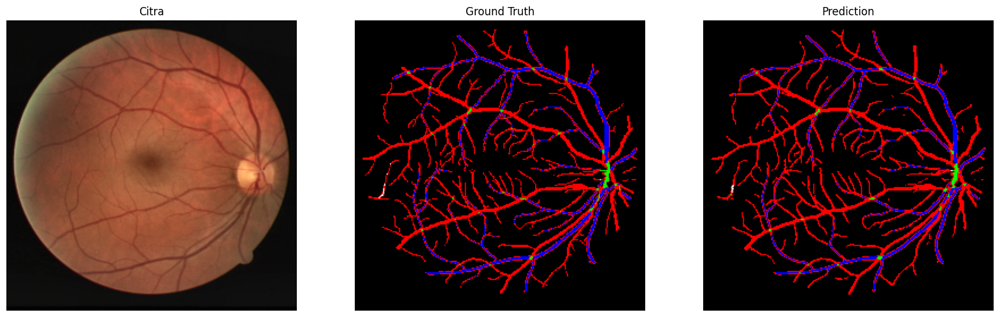

1/1 [==============================] - 0s 32ms/step


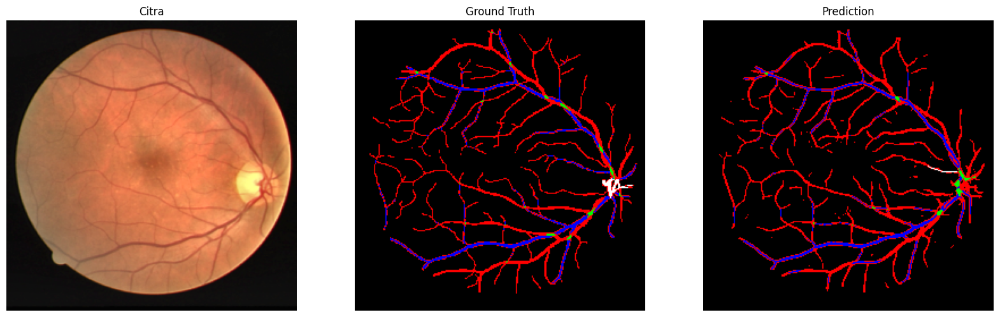

1/1 [==============================] - 0s 24ms/step


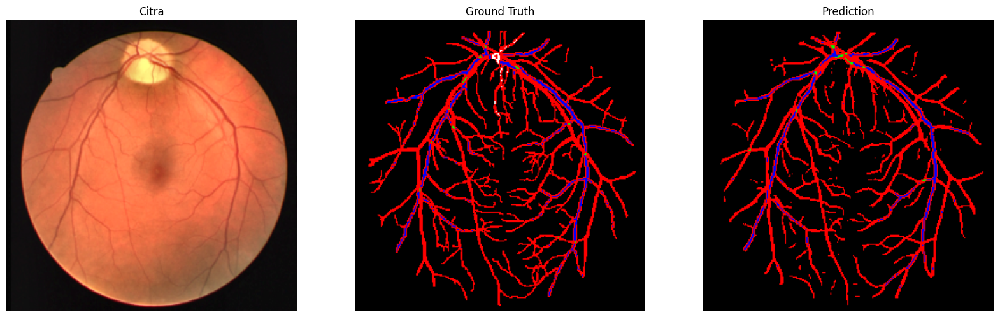

1/1 [==============================] - 0s 38ms/step


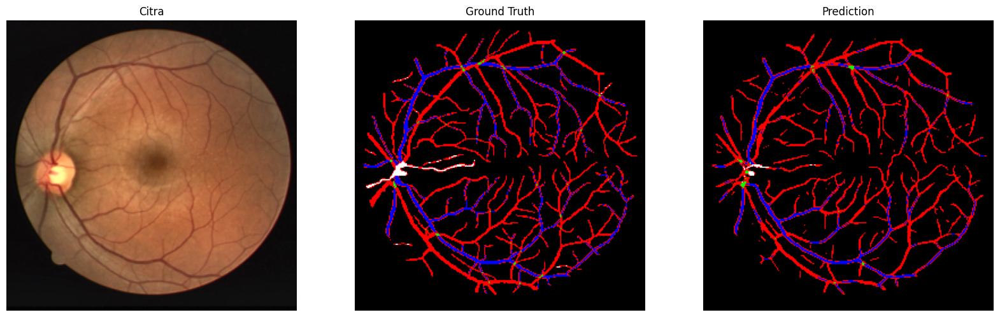

1/1 [==============================] - 0s 32ms/step


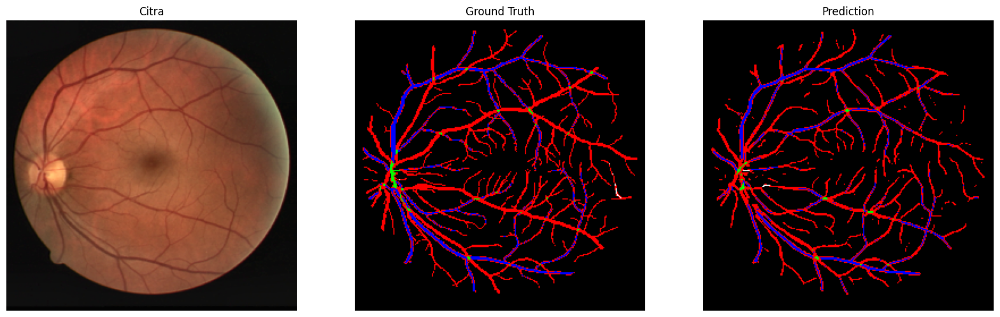

1/1 [==============================] - 0s 32ms/step


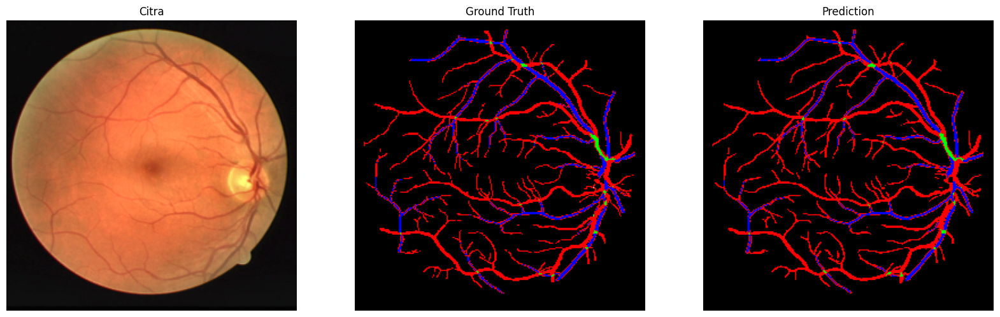

1/1 [==============================] - 0s 26ms/step


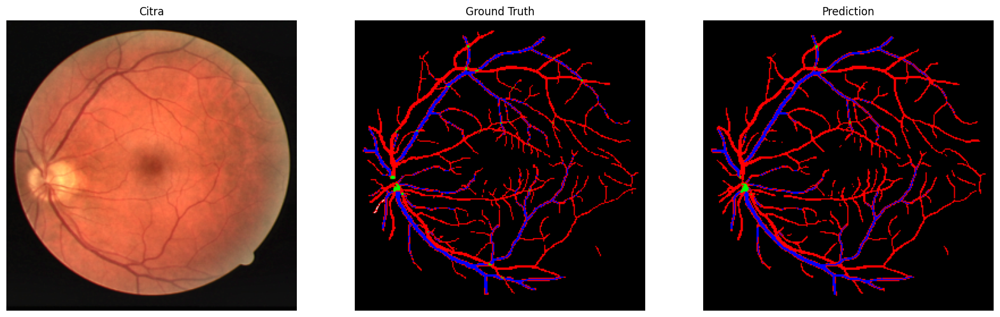

1/1 [==============================] - 0s 31ms/step


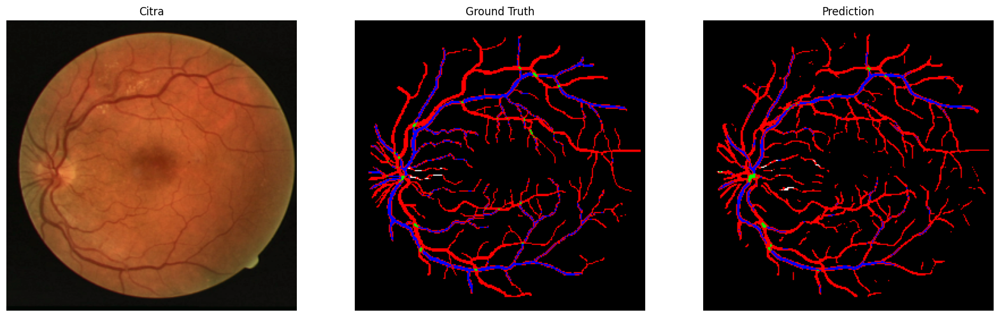

1/1 [==============================] - 0s 38ms/step


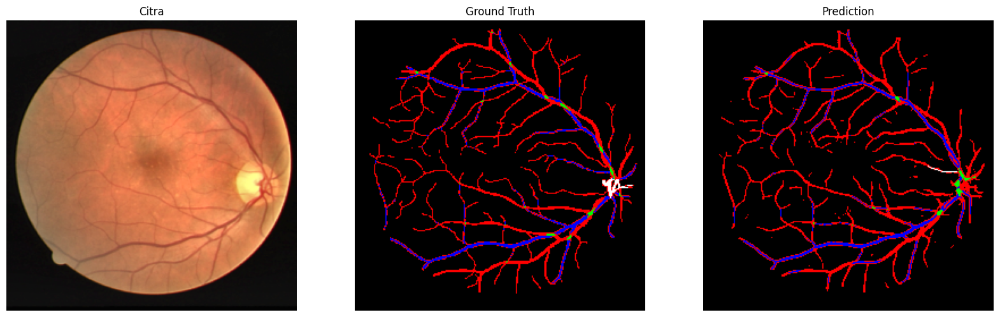

1/1 [==============================] - 0s 29ms/step


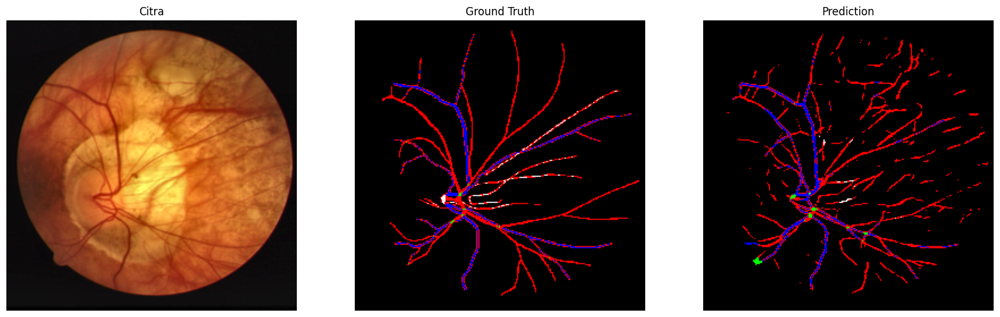

1/1 [==============================] - 0s 31ms/step


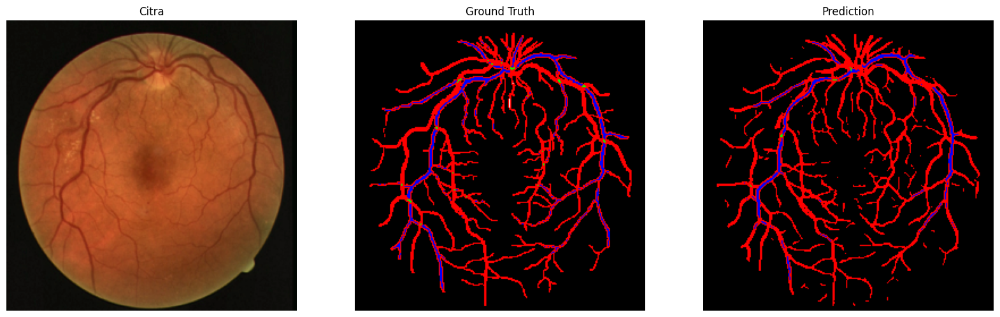

1/1 [==============================] - 0s 32ms/step


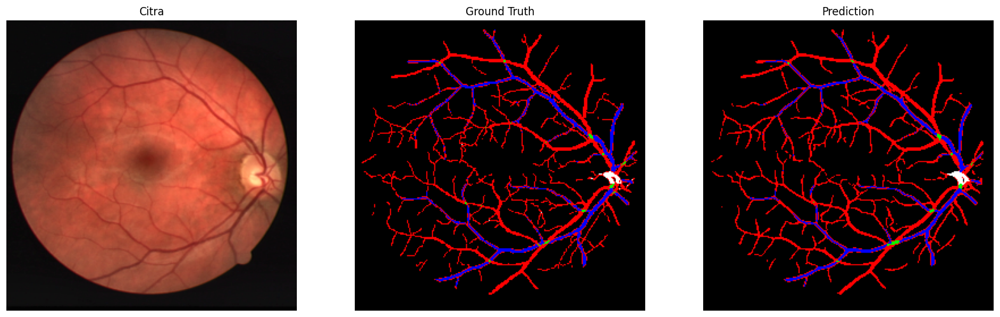

1/1 [==============================] - 0s 32ms/step


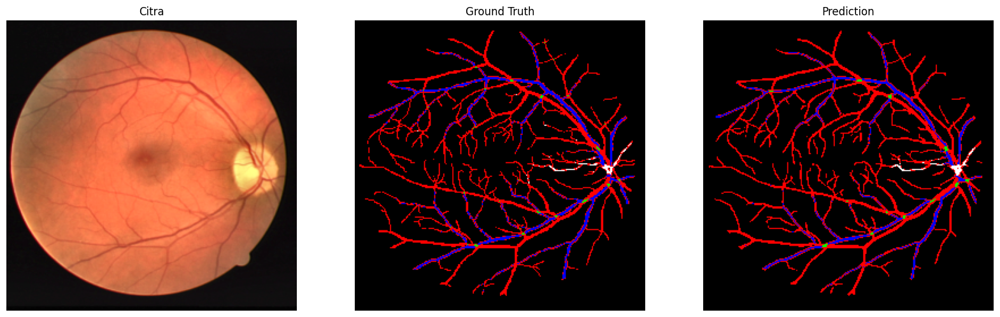

1/1 [==============================] - 0s 33ms/step


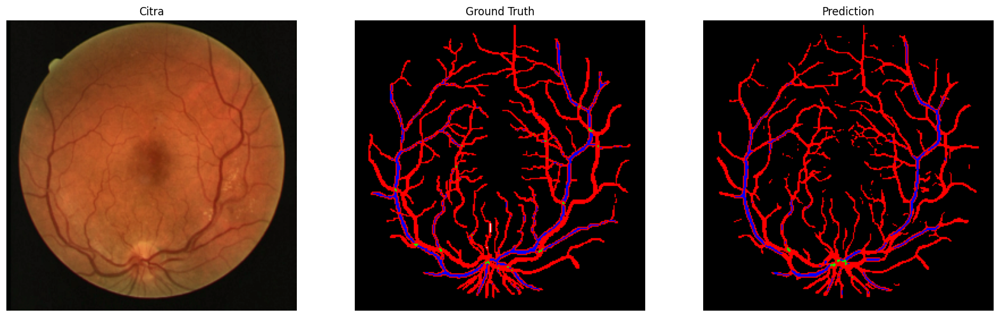

1/1 [==============================] - 0s 50ms/step


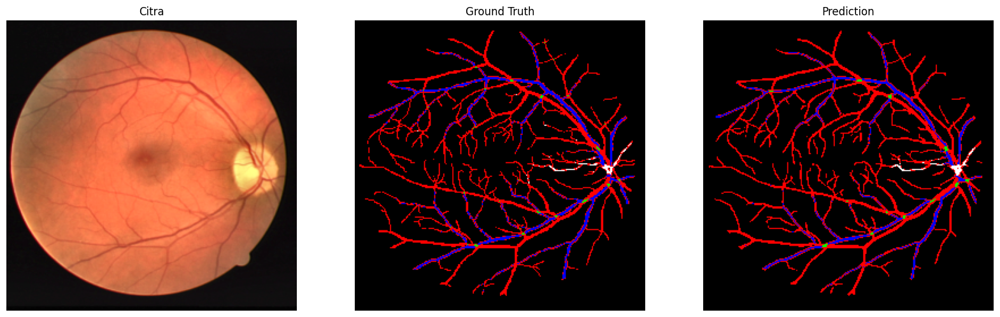

1/1 [==============================] - 0s 30ms/step


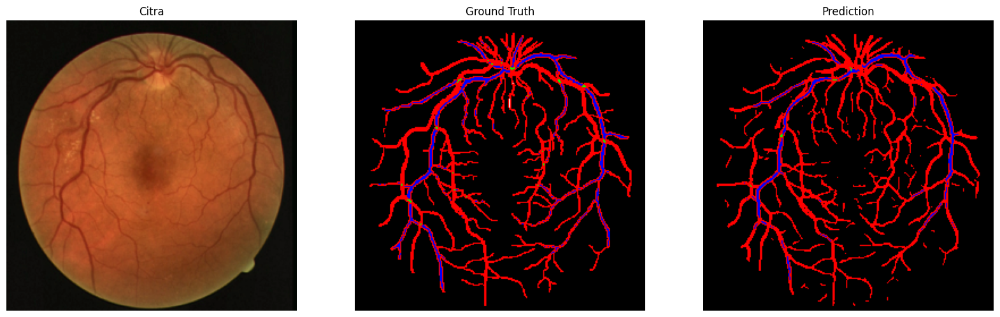

1/1 [==============================] - 0s 34ms/step


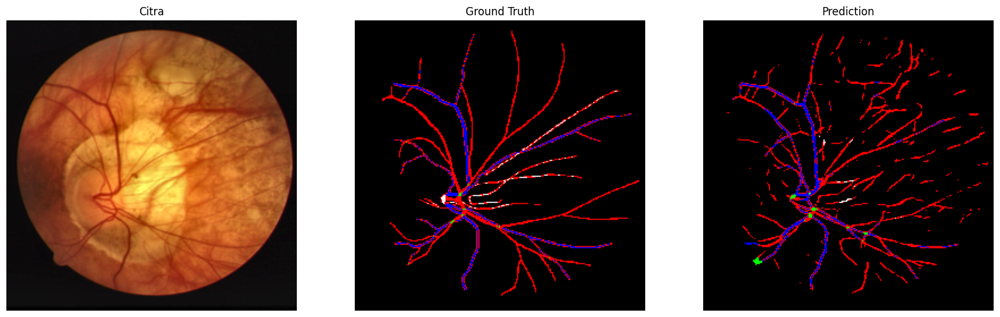

1/1 [==============================] - 0s 33ms/step


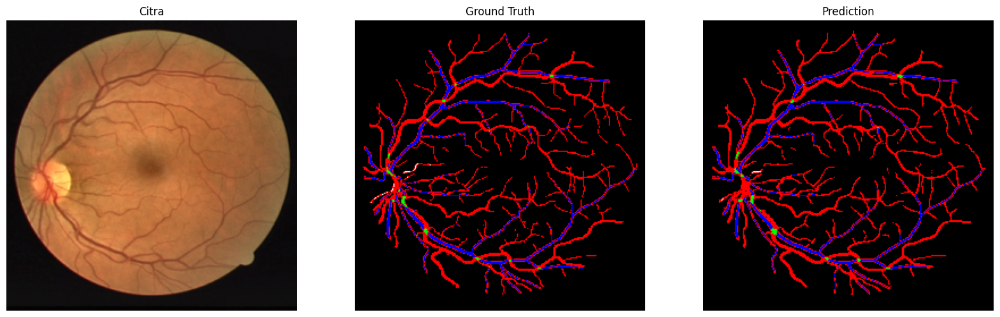

1/1 [==============================] - 0s 30ms/step


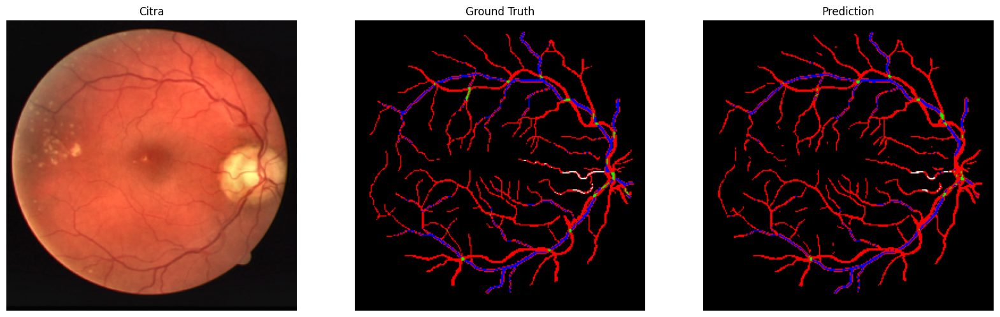

1/1 [==============================] - 0s 30ms/step


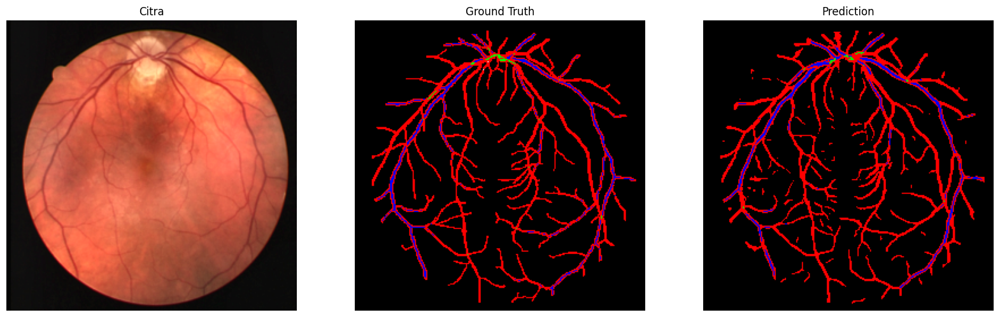

1/1 [==============================] - 0s 34ms/step


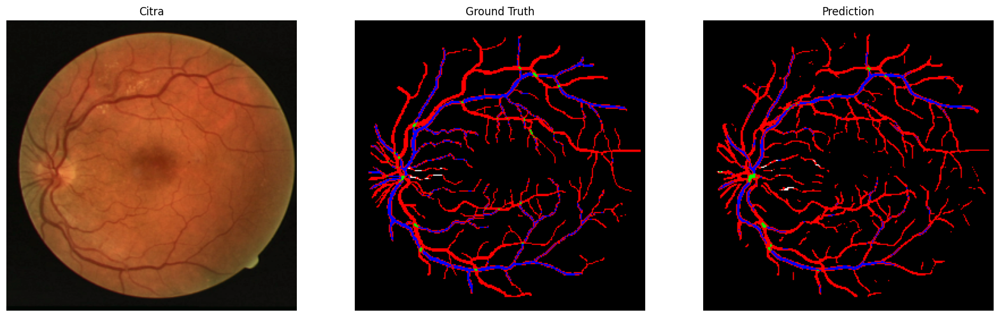

1/1 [==============================] - 0s 38ms/step


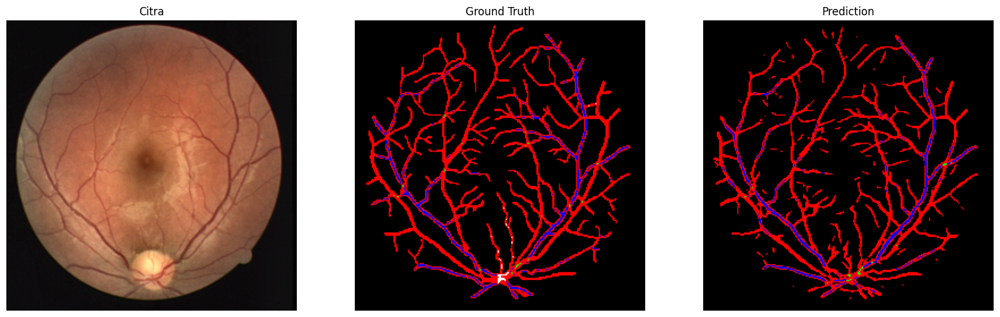

1/1 [==============================] - 0s 32ms/step


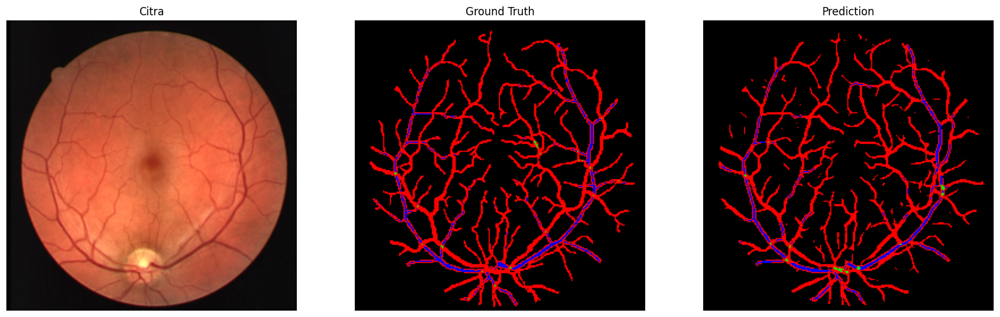

1/1 [==============================] - 0s 30ms/step


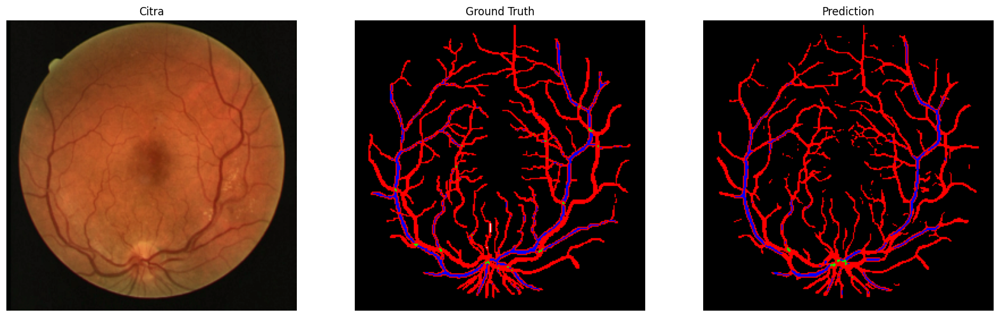

1/1 [==============================] - 0s 38ms/step


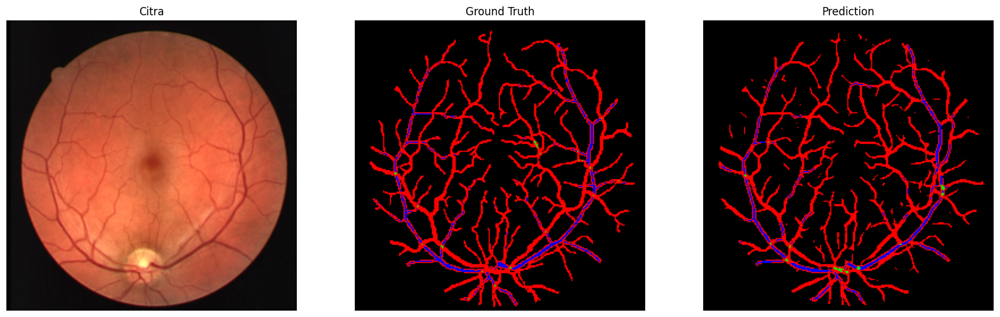

1/1 [==============================] - 0s 31ms/step


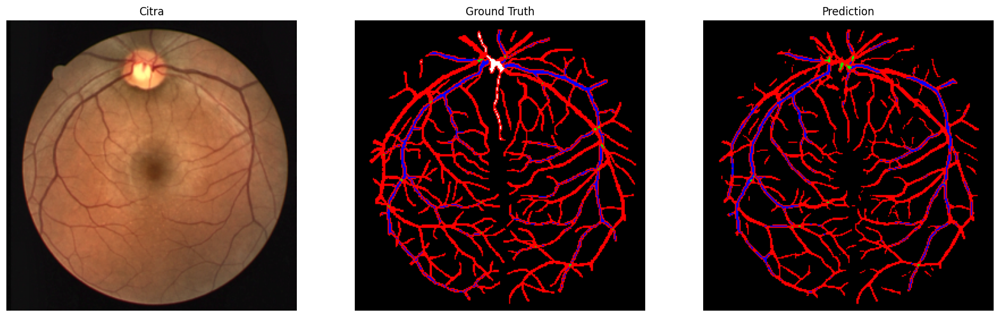

1/1 [==============================] - 0s 39ms/step


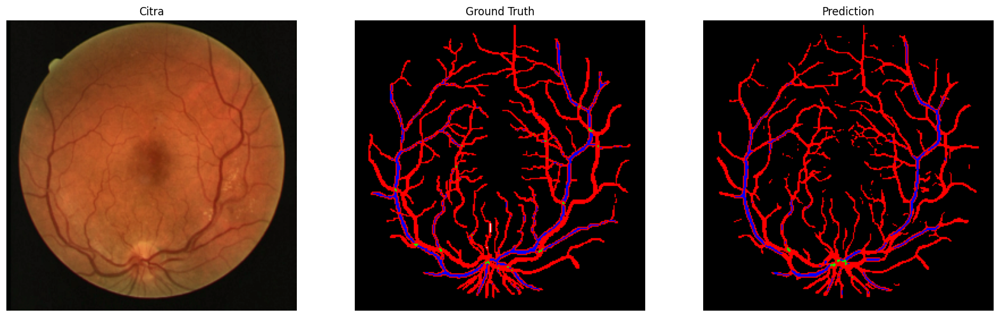

1/1 [==============================] - 0s 40ms/step


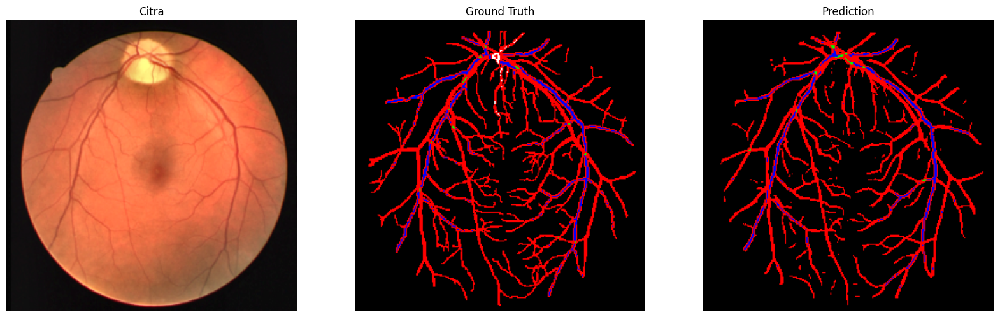

1/1 [==============================] - 0s 34ms/step


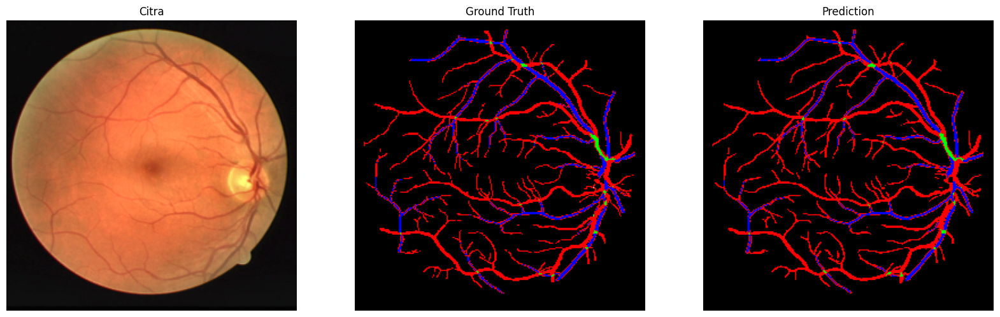

1/1 [==============================] - 0s 30ms/step


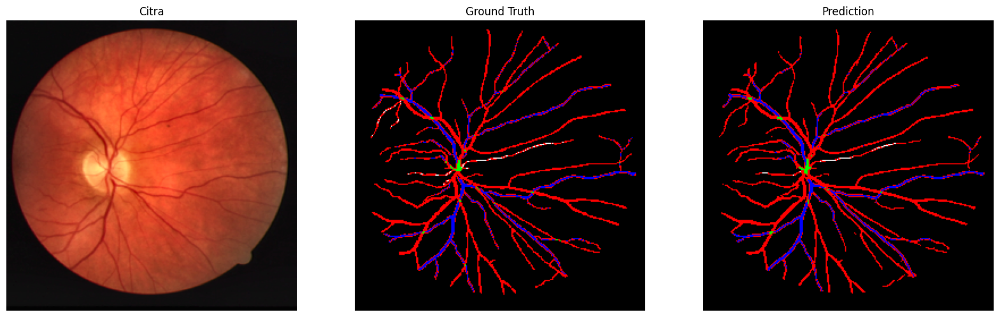

1/1 [==============================] - 0s 26ms/step


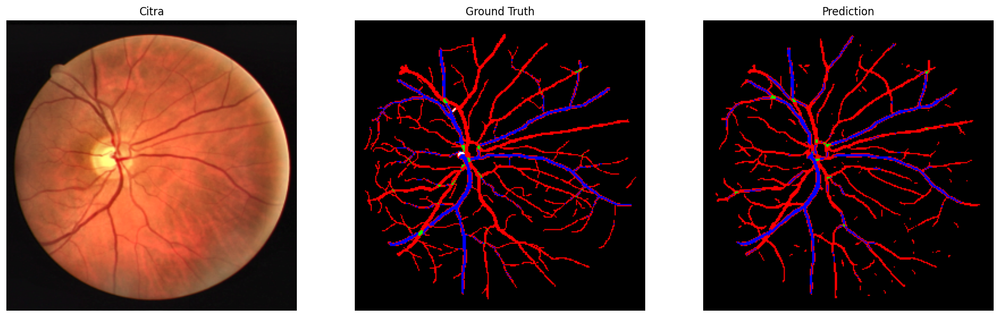

1/1 [==============================] - 0s 40ms/step


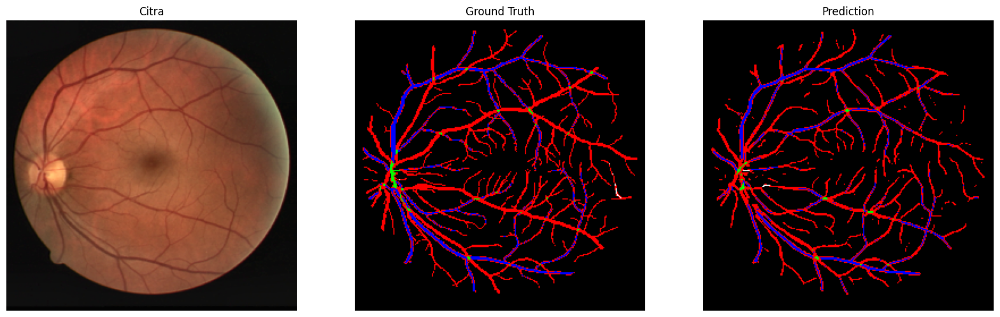

1/1 [==============================] - 0s 30ms/step


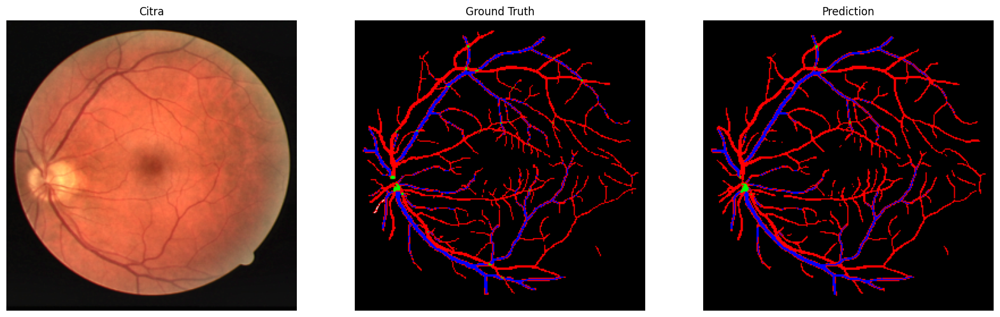

1/1 [==============================] - 0s 31ms/step


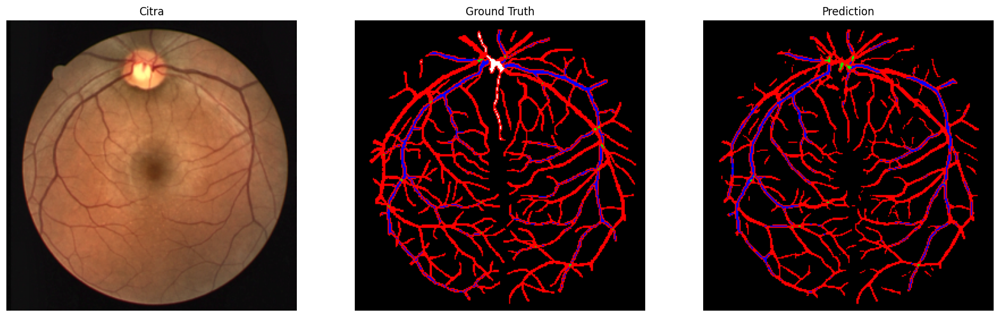

1/1 [==============================] - 0s 41ms/step


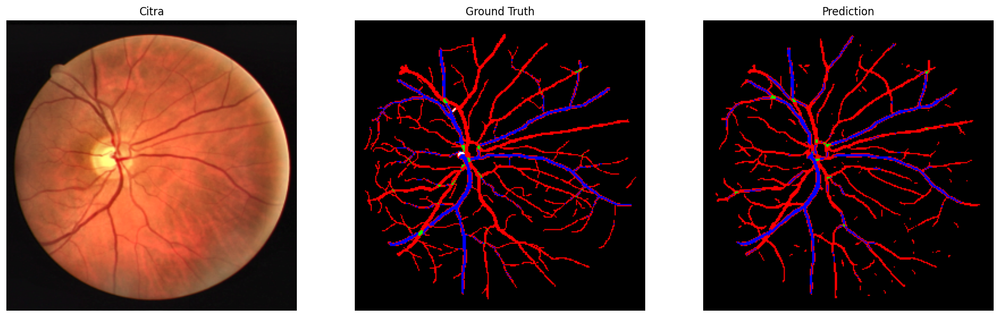

1/1 [==============================] - 0s 40ms/step


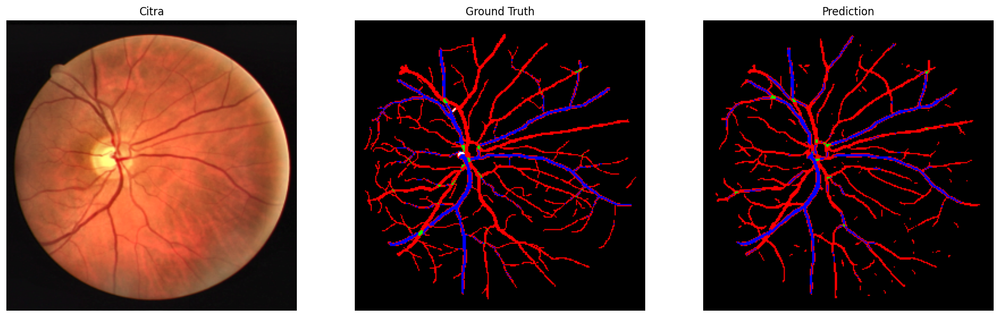

1/1 [==============================] - 0s 31ms/step


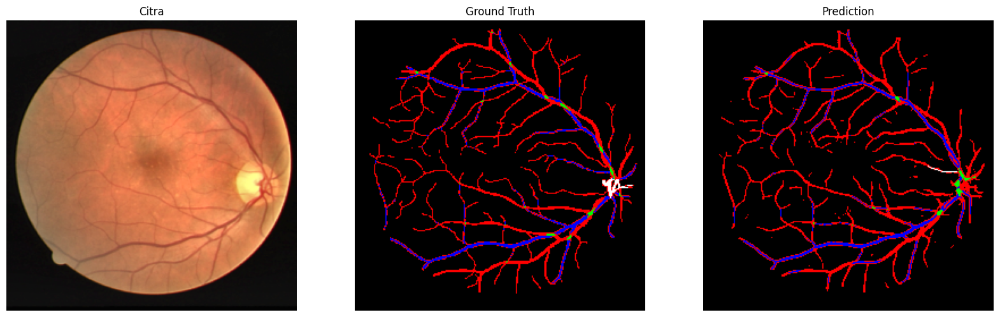

1/1 [==============================] - 0s 35ms/step


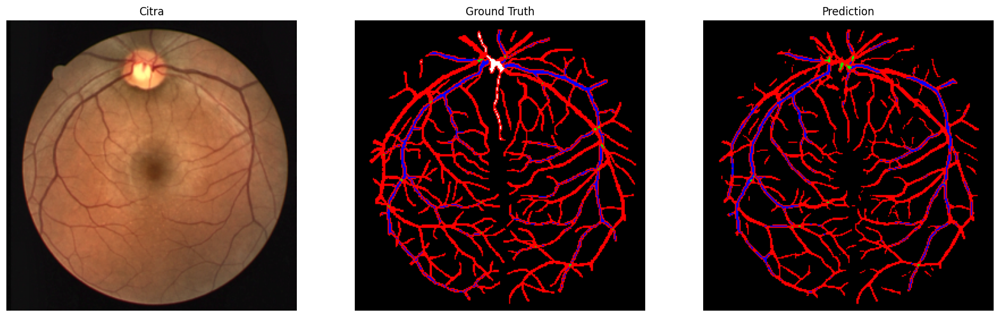

1/1 [==============================] - 0s 31ms/step


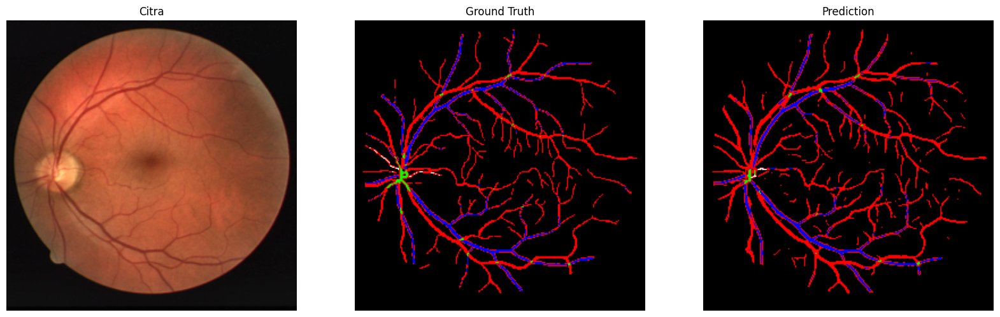

1/1 [==============================] - 0s 35ms/step


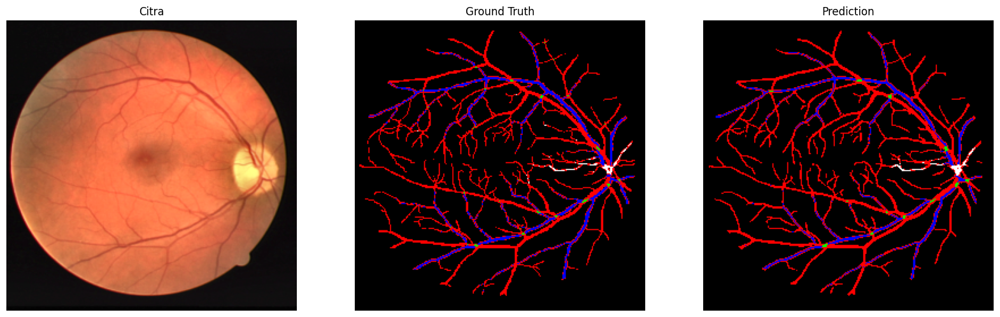

1/1 [==============================] - 0s 31ms/step


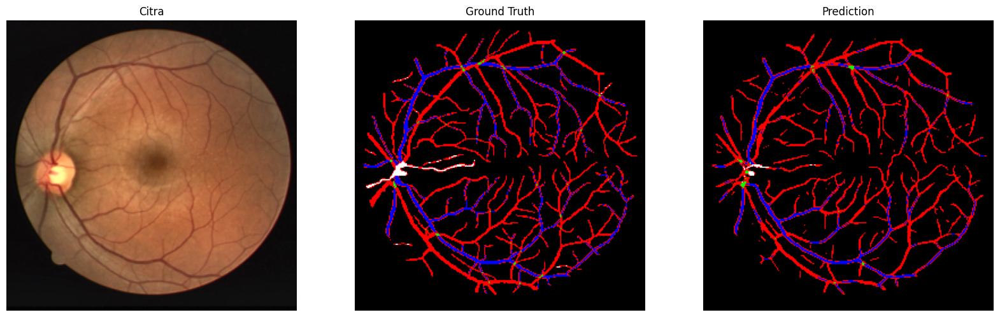

1/1 [==============================] - 0s 24ms/step


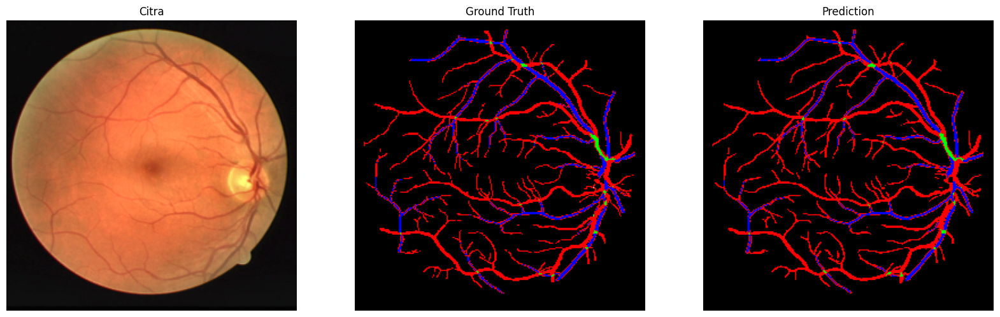

In [47]:
import numpy as np
from enum import Enum
import matplotlib.pyplot as plt

# Function to encode the mask to RGB
def rgb_encode_mask(mask):
    # Initialize rgb image with 3 channels (for RGB)
    rgb_encode_image = np.zeros((mask.shape[0], mask.shape[1], 3))

    # Iterate over MaskColorMap
    for j, cls in enumerate(MaskColorMap):
        # Convert single integer channel to RGB channels
        rgb_encode_image[mask == j] = np.array(cls.value) / 255.0
    
    return rgb_encode_image

# Function to display images
def display_images(instances, rows, titles=None, figsize=(20, 20)):
    fig, axes = plt.subplots(rows, len(instances) // rows, figsize=figsize)
    for j, image in enumerate(instances):
        plt.subplot(rows, len(instances) // rows, j + 1)
        plt.imshow(image)
        plt.title('' if titles is None else titles[j])
        plt.axis("off")
    plt.show()

# Example loop to visualize predictions
for _ in range(50):
    # Choose random number from 0 to test set size
    test_img_number = np.random.randint(0, len(X_test))

    # Extract test input image
    test_img = X_test[test_img_number]

    # Ground truth test label converted from one-hot to integer encoding
    ground_truth = np.argmax(Y_test[test_img_number], axis=-1)

    # Expand first dimension as U-Net requires (m, h, w, nc) input shape
    test_img_input = np.expand_dims(test_img, 0)

    # Make prediction with model and remove extra dimension
    prediction = np.squeeze(model.predict(test_img_input))

    # Convert softmax probabilities to integer values
    predicted_img = np.argmax(prediction, axis=-1)

    # Convert integer encoding to rgb values
    rgb_image = rgb_encode_mask(predicted_img)
    rgb_ground_truth = rgb_encode_mask(ground_truth)

    # Visualize model predictions
    display_images(
        [test_img[..., :3], rgb_ground_truth, rgb_image],
        rows=1, titles=['Citra', 'Ground Truth', 'Prediction']
    )


In [48]:
model_dir = 'D:/Gio&Maul/gio/AV_groundTruth/'
model_name = 'mresuneta-4.hdf5'
model.save(os.path.join(model_dir, model_name))

In [49]:
from tensorflow.keras.models import load_model
model = load_model(model_dir + model_name, custom_objects={'iou_coef':iou_coef})

In [50]:
model.load_weights(model_dir+model_name)

pred=model.predict(X_test)
pred=np.argmax(pred,axis=3)
pred.shape

1/1 [==============================] - 2s 2s/step


(28, 256, 256)

In [51]:
from sklearn.metrics import confusion_matrix, classification_report

In [52]:
Y_test1=np.argmax(Y_test,axis=3)
pred=pred.flatten()
Y_test1=Y_test1.flatten()
print(confusion_matrix(Y_test1,pred))


[[ 137509     755    8160     177   42661]
 [   1041     950     445      16      19]
 [  13393     324   28505      55     494]
 [    791     119      53     301     158]
 [  33848      21     134      41 1565038]]


In [53]:
Y_test1

array([4, 4, 4, ..., 4, 4, 4], dtype=int64)

In [54]:
#attmultiresunet jupyter
print(classification_report(Y_test1,pred))

              precision    recall  f1-score   support

           0       0.74      0.73      0.73    189262
           1       0.44      0.38      0.41      2471
           2       0.76      0.67      0.71     42771
           3       0.51      0.21      0.30      1422
           4       0.97      0.98      0.98   1599082

    accuracy                           0.94   1835008
   macro avg       0.68      0.59      0.63   1835008
weighted avg       0.94      0.94      0.94   1835008



In [55]:
# Hitung IOU pada data validasi atau data uji
nilai_iou = iou_coef(Y_train, model.predict(X_train))

print("IOU pada model terakhir:", nilai_iou)

8/8 [==============================] - 2s 179ms/step
IOU pada model terakhir: tf.Tensor(0.714743, shape=(), dtype=float32)


In [56]:
from keras_unet.utils import plot_segm_history
import matplotlib.pyplot as plt

# Memastikan metrik yang ada dalam history
print(history.history.keys())

# Plot the history
plot_segm_history(
    history,
    metrics=['iou_coef', 'val_iou_coef']
)
plt.show()


dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])


KeyError: 'iou_coef'

<Figure size 1200x600 with 0 Axes>